### 1. pip Install

In [37]:

!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="3hhfZRx9h7E2tuowPNtq")
project = rf.workspace("jrprojects-zjf9f").project("construction-activities-fmp8-v")
version = project.version(6)
dataset = version.download("yolov8")


loading Roboflow workspace...
loading Roboflow project...


### 2. Train model

In [38]:


import os

!pip install ultralytics roboflow
from ultralytics import YOLO
from roboflow import Roboflow

# Load a model (Using 'n' model for better speed/nano version)
model = YOLO("yolov8n.pt")

# Ensure dataset is downloaded cleanly
rf = Roboflow(api_key="3hhfZRx9h7E2tuowPNtq")
project = rf.workspace("jrprojects-zjf9f").project("construction-activities-fmp8-v")
version = project.version(6)
# overwrite=True forces a fresh download to fix missing files
dataset = version.download("yolov8", overwrite=True)

# Use the model
# Use the dataset.location from the previous step to find the data.yaml file
results = model.train(data=os.path.join(dataset.location, "data.yaml"), epochs=30)

loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to Construction-Activities---FMP8.v-6 in yolov8:: 100%|██████████| 595/595 [00:00<00:00, 5677.18it/s]

New https://pypi.org/project/ultralytics/8.4.17 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.4.16 🚀 Python-3.12.12 torch-2.10.0+cu128 CUDA:0 (Tesla T4, 14913MiB)
engine/trainer: agnostic_nms=False, amp=True, angle=1.0, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/AECO-Safety-Detection-YOLOv8/Construction-Activities---FMP8.v-6/data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, end2end=None, epochs=30, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8n.pt, momentum=0

 16                  -1  1     36992  ultralytics.nn.modules.conv.Conv             [64, 64, 3, 2]                
 17            [-1, 12]  1         0  ultralytics.nn.modules.conv.Concat           [1]                           
 18                  -1  1    123648  ultralytics.nn.modules.block.C2f             [192, 128, 1]                 
 19                  -1  1    147712  ultralytics.nn.modules.conv.Conv             [128, 128, 3, 2]              
 20             [-1, 9]  1         0  ultralytics.nn.modules.conv.Concat           [1]                           
 21                  -1  1    493056  ultralytics.nn.modules.block.C2f             [384, 256, 1]                 
 22        [15, 18, 21]  1    752287  ultralytics.nn.modules.head.Detect           [5, 16, None, [64, 128, 256]] 
Model summary: 130 layers, 3,011,823 parameters, 3,011,807 gradients, 8.2 GFLOPs

Transferred 319/355 items from pretrained weights
Freezing layer 'model.22.dfl.conv.weight'
AMP: running Automatic Mixed

### 3. Testing

In [39]:
import glob
import random
import os
from ultralytics import YOLO
from PIL import Image as PILImage
from IPython.display import display

# Find the latest training run directory based on time
runs_dir = '/content/runs/detect'
if os.path.exists(runs_dir):
    # Get subdirectories
    subdirs = [os.path.join(runs_dir, d) for d in os.listdir(runs_dir) if os.path.isdir(os.path.join(runs_dir, d))]

    if subdirs:
        # Sort by modification time (newest last)
        latest_run = max(subdirs, key=os.path.getmtime)
        best_model_path = os.path.join(latest_run, 'weights', 'best.pt')
        print(f"Testing model from: {best_model_path}")

        if os.path.exists(best_model_path):
            # Load the best model
            best_model = YOLO(best_model_path)

            # Get a random image from the validation set
            # We use dataset.location from the previous step
            valid_images = glob.glob(os.path.join(dataset.location, 'valid', 'images', '*'))

            if valid_images:
                test_image = random.choice(valid_images)
                print(f"Predicting on: {test_image}")

                # Run prediction
                results = best_model.predict(test_image, conf=0.5)

                # Display result
                for result in results:
                    im_array = result.plot()  # plot a BGR numpy array of predictions
                    im = PILImage.fromarray(im_array[..., ::-1])  # Convert BGR to RGB
                    display(im)
            else:
                print("No images found in validation path.")
        else:
            print(f"best.pt not found in {latest_run}")
    else:
        print("No subdirectories found in runs/detect.")
else:
    print("No training runs found. Please run the training cell first.")

Testing model from: /content/runs/detect/val4/weights/best.pt
best.pt not found in /content/runs/detect/val4


### 4. Evaluation

In [40]:
import pandas as pd
import os

# Find the latest training run directory based on time
runs_dir = '/content/runs/detect'
if os.path.exists(runs_dir):
    # Get subdirectories
    subdirs = [os.path.join(runs_dir, d) for d in os.listdir(runs_dir) if os.path.isdir(os.path.join(runs_dir, d))]

    if subdirs:
        # Sort by modification time (newest last) to ensure we get the actual latest run
        latest_run = max(subdirs, key=os.path.getmtime)
        results_path = os.path.join(latest_run, 'results.csv')

        if os.path.exists(results_path):
            print(f"Loading results from: {results_path}")
            # Load the results CSV
            df_results = pd.read_csv(results_path)

            # Strip whitespace from column names
            df_results.columns = df_results.columns.str.strip()

            # Display the last few rows to see the final metrics
            display(df_results.tail())

            # Print the final precision
            # Note: Column names might vary slightly between versions
            precision_col = 'metrics/precision(B)'
            if precision_col in df_results.columns:
                final_precision = df_results[precision_col].iloc[-1]
                print(f"\nFinal Precision: {final_precision:.4f}")
            else:
                print(f"\nColumn '{precision_col}' not found. Available columns: {df_results.columns.tolist()}")
        else:
            print("results.csv not found in the latest run directory.")
    else:
        print("No subdirectories found in runs/detect.")
else:
    print("No training runs found.")

results.csv not found in the latest run directory.


## 5. Switch to Medium Model and Run Training


### Subtask:
Train the YOLOv8 Medium model (yolov8m.pt) on the dataset.
**Reasoning**:

The user wants to train the YOLOv8 Medium model. The dataset is already available from previous steps. initialize the model with 'yolov8m.pt' and start the training process for 50 epochs.



In [41]:
from ultralytics import YOLO
import os

# Load the YOLOv8 Medium model
model_medium = YOLO("yolov8m.pt")

# Define the path to the dataset configuration file
# Based on previous cells, the dataset location is likely here
dataset_yaml = "/content/Construction-Activities---FMP8.v-6/data.yaml"

# Train the model
# We name the project 'runs/detect' and the run 'train_medium' for clarity
results_medium = model_medium.train(
    data=dataset_yaml,
    epochs=30,
    name='train_medium'
)

New https://pypi.org/project/ultralytics/8.4.17 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.4.16 🚀 Python-3.12.12 torch-2.10.0+cu128 CUDA:0 (Tesla T4, 14913MiB)
engine/trainer: agnostic_nms=False, amp=True, angle=1.0, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/Construction-Activities---FMP8.v-6/data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, end2end=None, epochs=30, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8m.pt, momentum=0.937, mosaic=1.0, multi_scale

### 6. the training metrics by loading the results CSV file and performing an inference test on a randomly selected image from the validation set using the newly trained weights.



Running validation...
Ultralytics 8.4.16 🚀 Python-3.12.12 torch-2.10.0+cu128 CUDA:0 (Tesla T4, 14913MiB)
Model summary (fused): 93 layers, 25,842,655 parameters, 0 gradients, 78.7 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 1248.5±503.5 MB/s, size: 70.0 KB)
val: Scanning /content/Construction-Activities---FMP8.v-6/valid/labels.cache... 25 images, 0 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 25/25 7.5Mit/s 0.0s
WARNING ⚠️ Box and segment counts should be equal, but got len(segments) = 25, len(boxes) = 46. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.3it/s 1.5s
                   all         25         46      0.629      0.458      0.456      0.232
- collaborate with your team on computer vision projects          1          3          1 

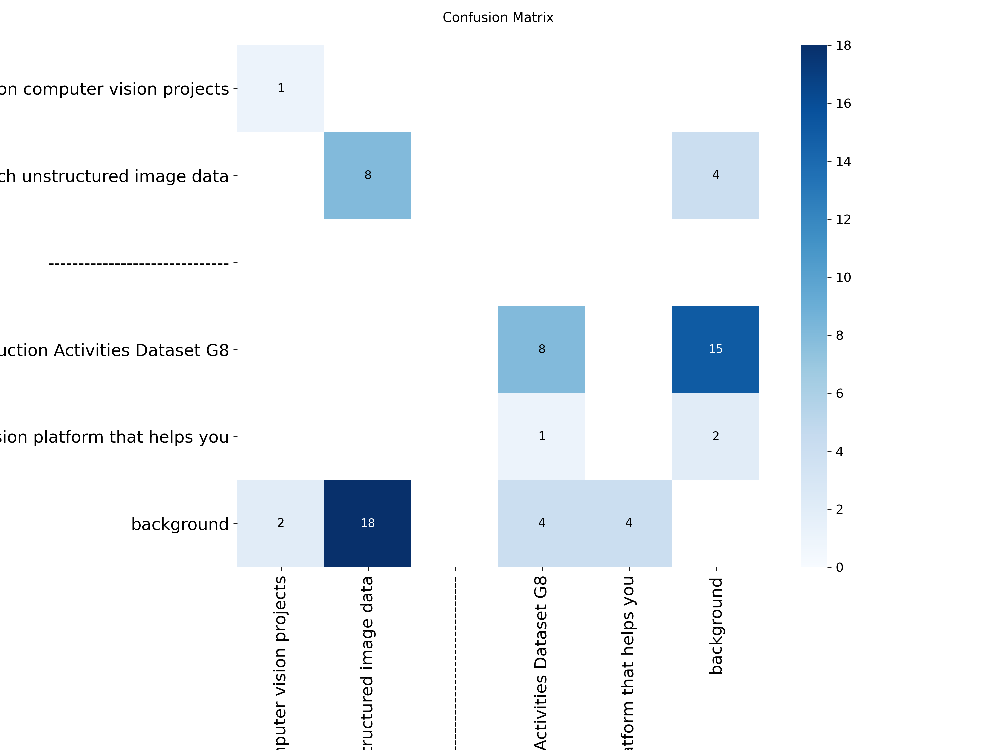


Displaying results.png:


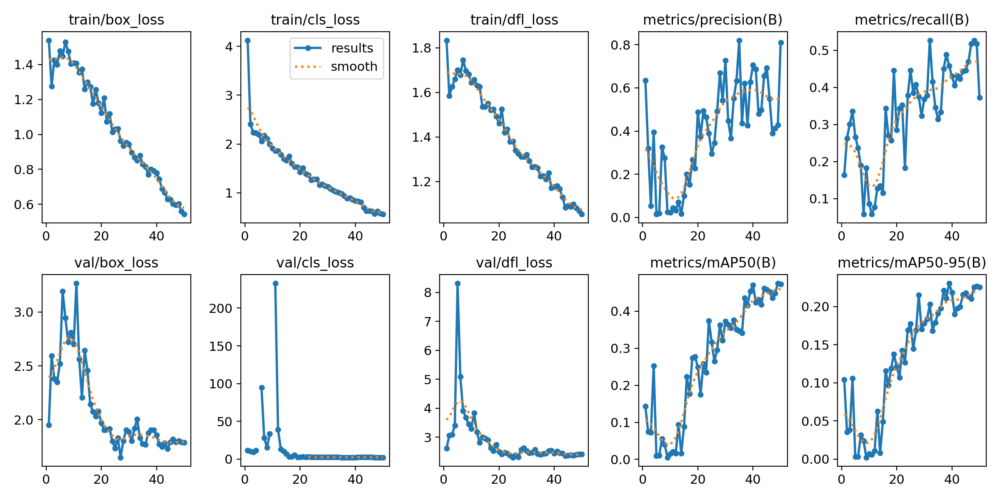

In [42]:
from ultralytics import YOLO
import os
from IPython.display import Image, display

# Load the best model weights
run_dir = '/content/runs/detect/train_medium'
best_weights = os.path.join(run_dir, 'weights', 'best.pt')
model = YOLO(best_weights)

# Run validation to get detailed metrics
print("Running validation...")
metrics = model.val()

# Display the confusion matrix and other key charts from the training run
print("\n--- Evaluation Plots ---")
plots = ['confusion_matrix.png', 'results.png', 'PR_curve.png']

for plot in plots:
    path = os.path.join(run_dir, plot)
    if os.path.exists(path):
        print(f"\nDisplaying {plot}:")
        display(Image(filename=path))

Loading results from: /content/runs/detect/train_medium/results.csv


,epoch,time,train/box_loss,train/cls_loss,train/dfl_loss,metrics/precision(B),metrics/recall(B),metrics/mAP50(B),metrics/mAP50-95(B),val/box_loss,val/cls_loss,val/dfl_loss,lr/pg0,lr/pg1,lr/pg2
45,46,431.055,0.60291,0.62281,1.08867,0.55013,0.46955,0.45206,0.21339,1.81951,2.31356,2.38952,0.000121,0.000121,0.000121
46,47,440.301,0.59636,0.57183,1.09936,0.38875,0.51763,0.43593,0.21034,1.79140,2.21833,2.36602,0.000099,0.000099,0.000099
47,48,449.573,0.60292,0.62390,1.08204,0.41171,0.52724,0.44827,0.22539,1.80391,2.15985,2.39866,0.000077,0.000077,0.000077
48,49,458.849,0.56122,0.57832,1.06918,0.42743,0.51763,0.47478,0.22637,1.79111,2.18483,2.40913,0.000055,0.000055,0.000055
49,50,468.085,0.54303,0.56239,1.05399,0.81122,0.37295,0.47203,0.22537,1.78564,2.17472,2.41780,0.000033,0.000033,0.000033



Final mAP50-95: 0.2254

Testing model from: /content/runs/detect/train_medium/weights/best.pt
Predicting on: /content/Construction-Activities---FMP8.v-6/valid/images/31_png_jpg.rf.95bd1946e66c372b2f9f4d131b249412.jpg

image 1/1 /content/Construction-Activities---FMP8.v-6/valid/images/31_png_jpg.rf.95bd1946e66c372b2f9f4d131b249412.jpg: 640x640 (no detections), 36.8ms
Speed: 1.9ms preprocess, 36.8ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


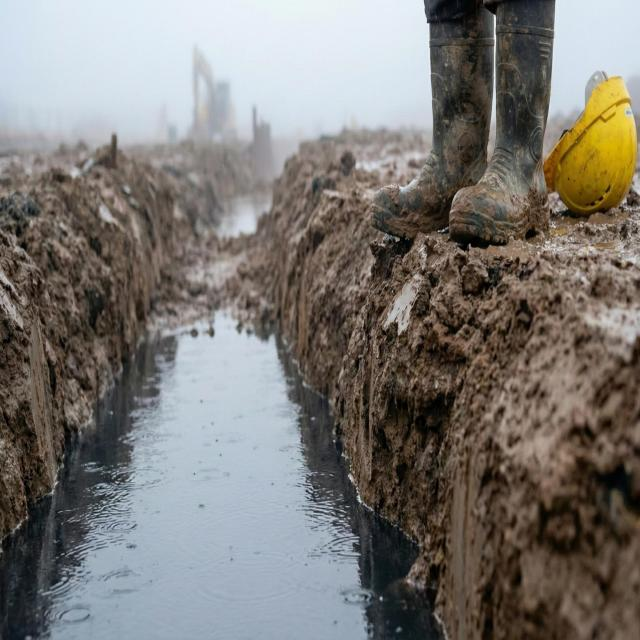

In [43]:
import pandas as pd
import os
import glob
import random
from ultralytics import YOLO
from PIL import Image as PILImage
from IPython.display import display

# Define the run directory
run_dir = '/content/runs/detect/train_medium'
results_path = os.path.join(run_dir, 'results.csv')

# 1. Display training metrics from CSV
if os.path.exists(results_path):
    print(f"Loading results from: {results_path}")
    df_results = pd.read_csv(results_path)
    # Clean column names
    df_results.columns = df_results.columns.str.strip()
    display(df_results.tail())

    # Print final mAP50-95 if column exists
    map_col = 'metrics/mAP50-95(B)'
    if map_col in df_results.columns:
        print(f"\nFinal mAP50-95: {df_results[map_col].iloc[-1]:.4f}")

# 2. Test the trained model on a validation image
best_weights = os.path.join(run_dir, 'weights', 'best.pt')
if os.path.exists(best_weights):
    print(f"\nTesting model from: {best_weights}")
    # Load the best model weights
    model = YOLO(best_weights)

    # Define dataset location based on previous steps
    dataset_location = '/content/Construction-Activities---FMP8.v-6'
    valid_images = glob.glob(os.path.join(dataset_location, 'valid', 'images', '*'))

    if valid_images:
        test_image = random.choice(valid_images)
        print(f"Predicting on: {test_image}")

        # Run prediction
        results = model.predict(test_image, conf=0.5)

        # Display result
        for result in results:
            im_array = result.plot() # plot a BGR numpy array of predictions
            im = PILImage.fromarray(im_array[..., ::-1]) # Convert BGR to RGB
            display(im)
    else:
        print("No validation images found.")
else:
    print("Best weights not found.")

Displaying all evaluation results from: /content/runs/detect/train_medium

--- BoxF1_curve.png ---


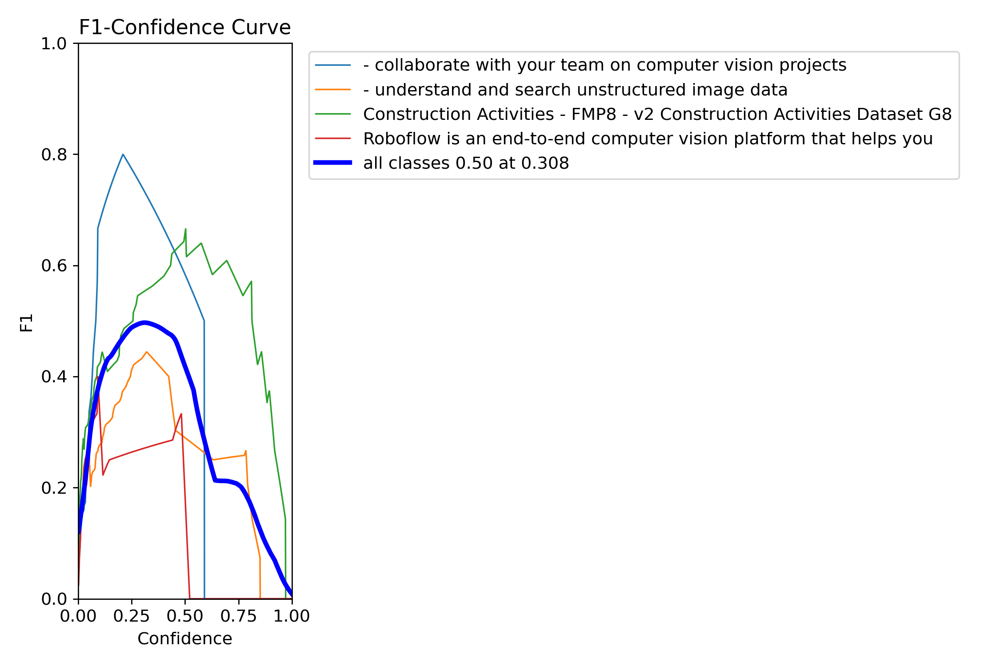


--- BoxPR_curve.png ---


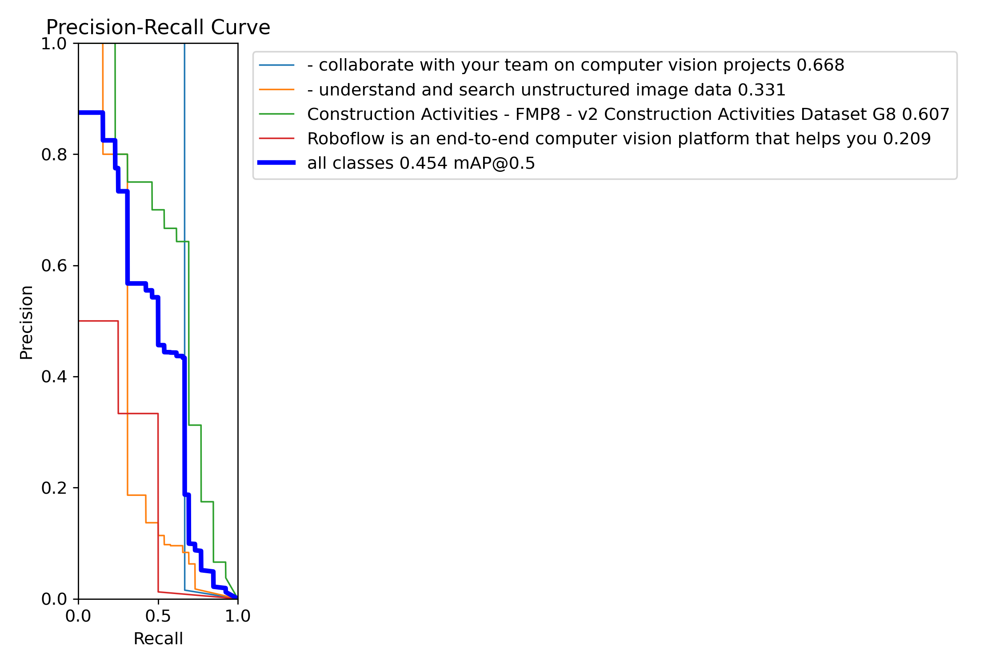


--- BoxP_curve.png ---


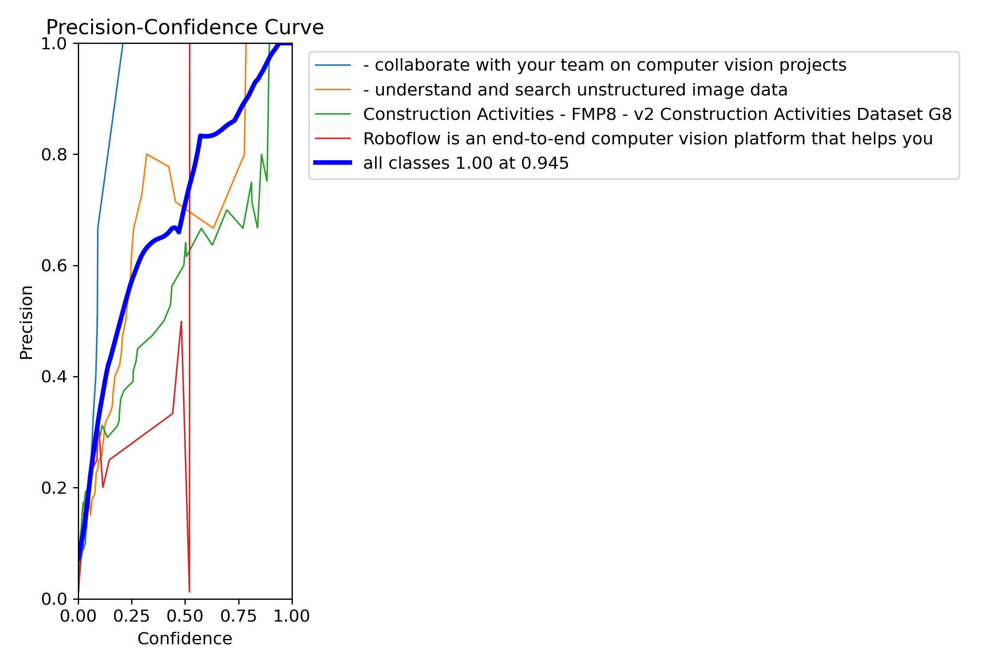


--- BoxR_curve.png ---


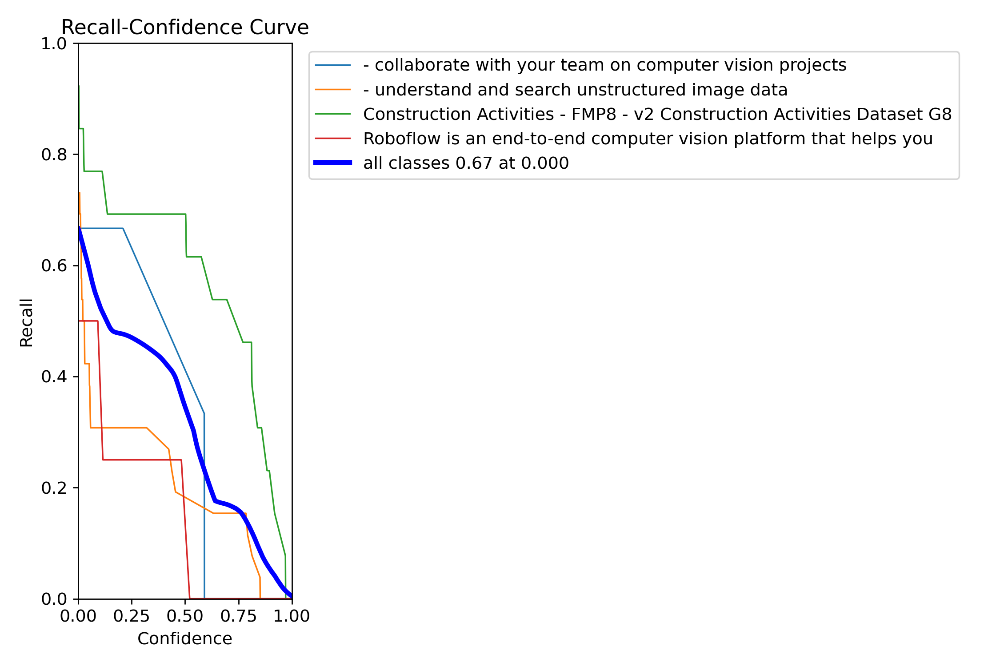


--- confusion_matrix.png ---


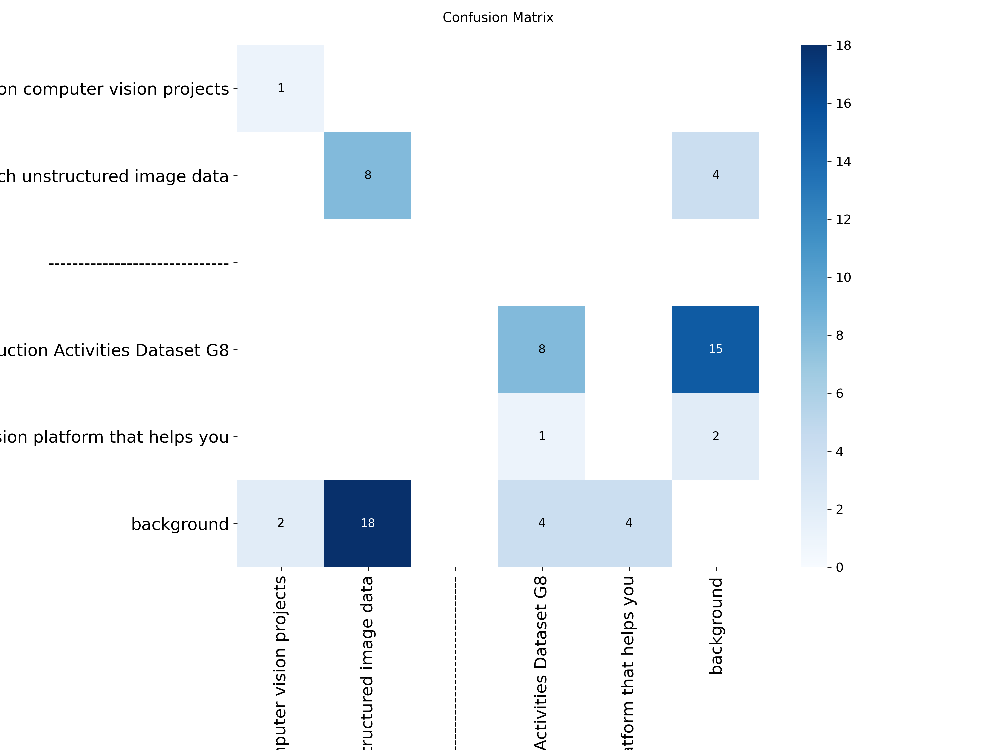


--- confusion_matrix_normalized.png ---


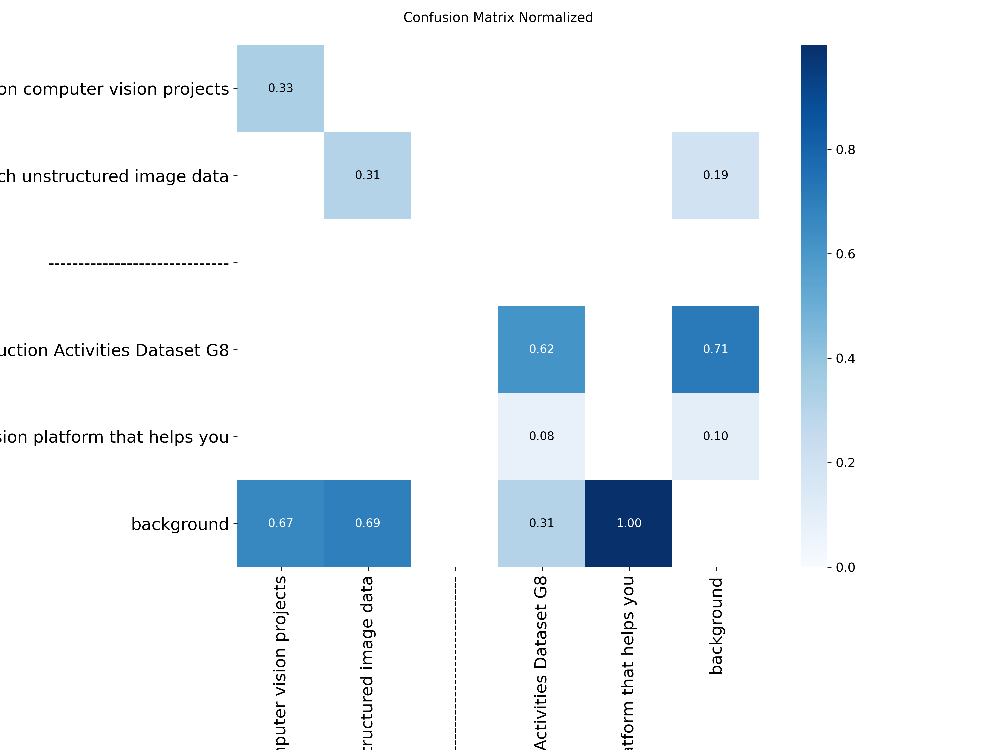


--- labels.jpg ---


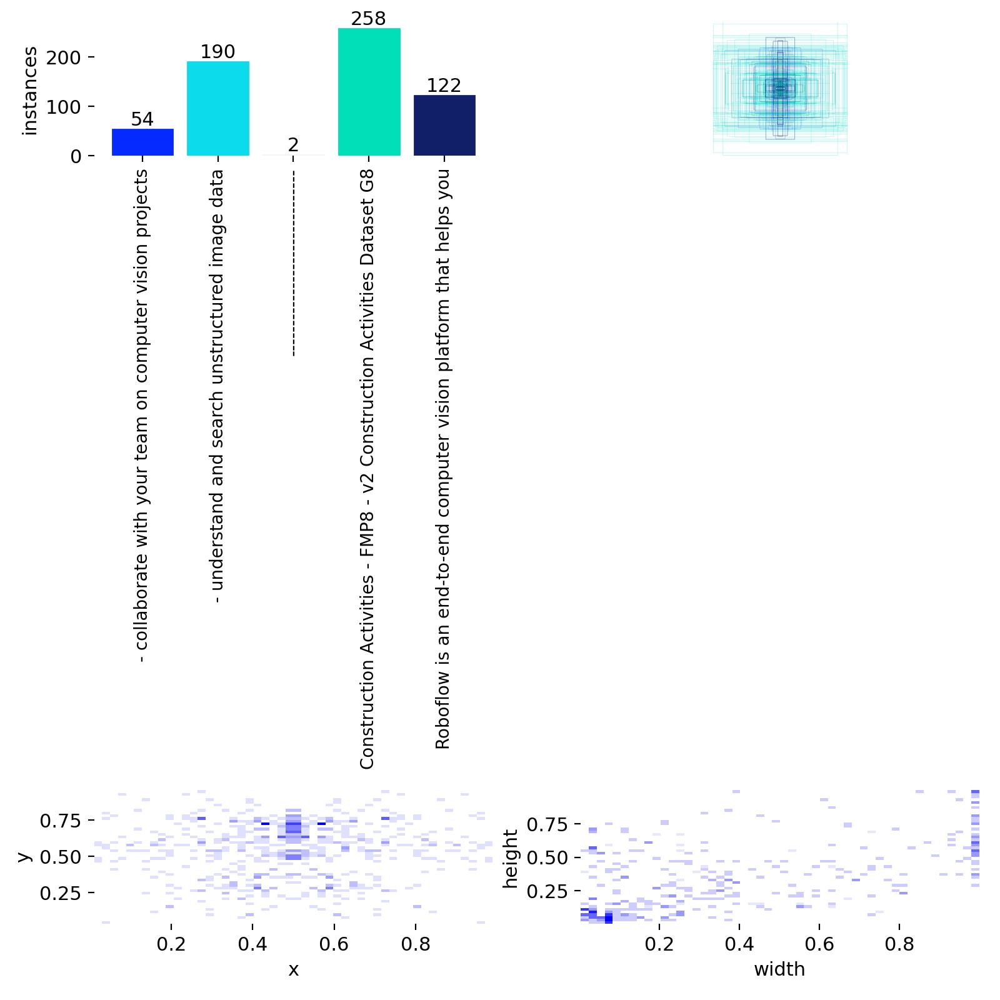


--- results.png ---


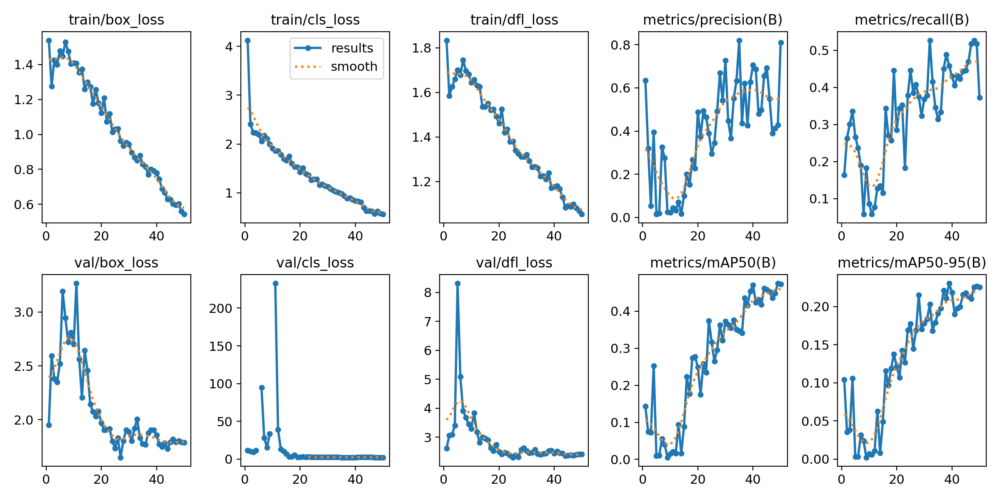


--- train_batch0.jpg ---


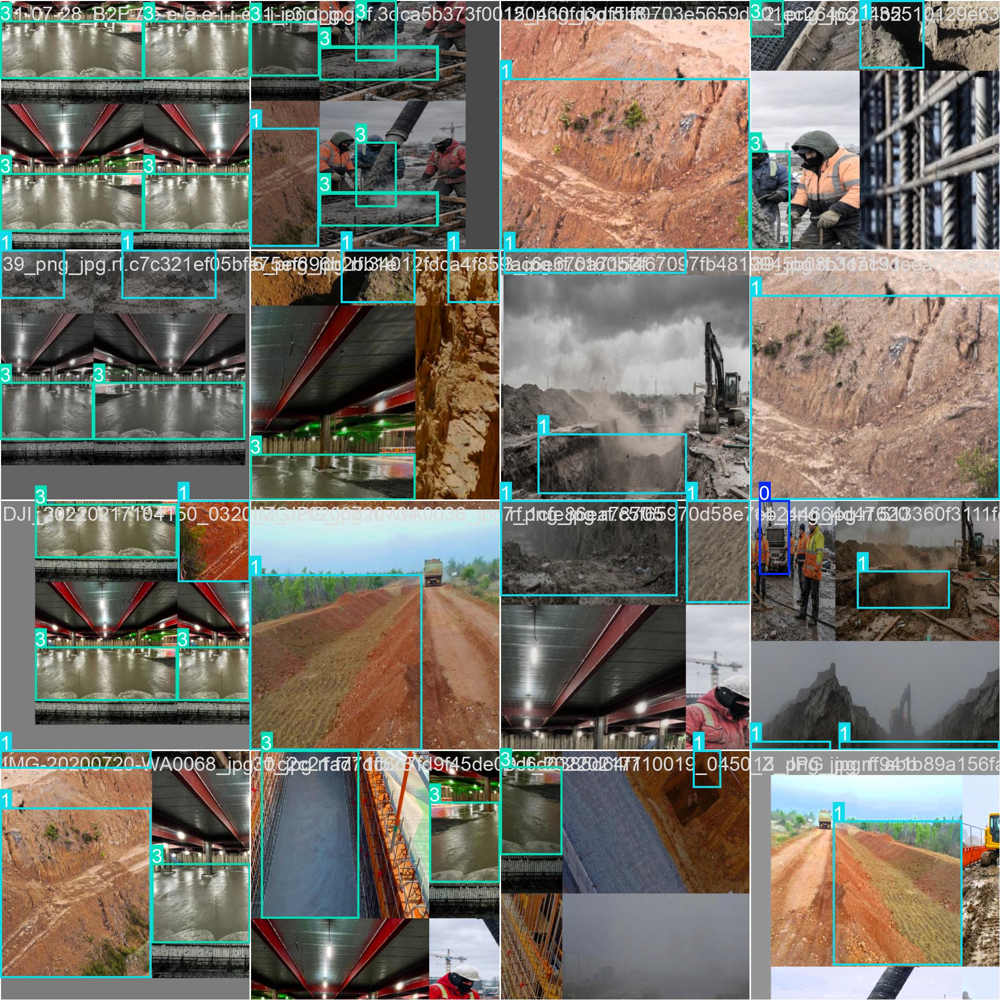


--- train_batch1.jpg ---


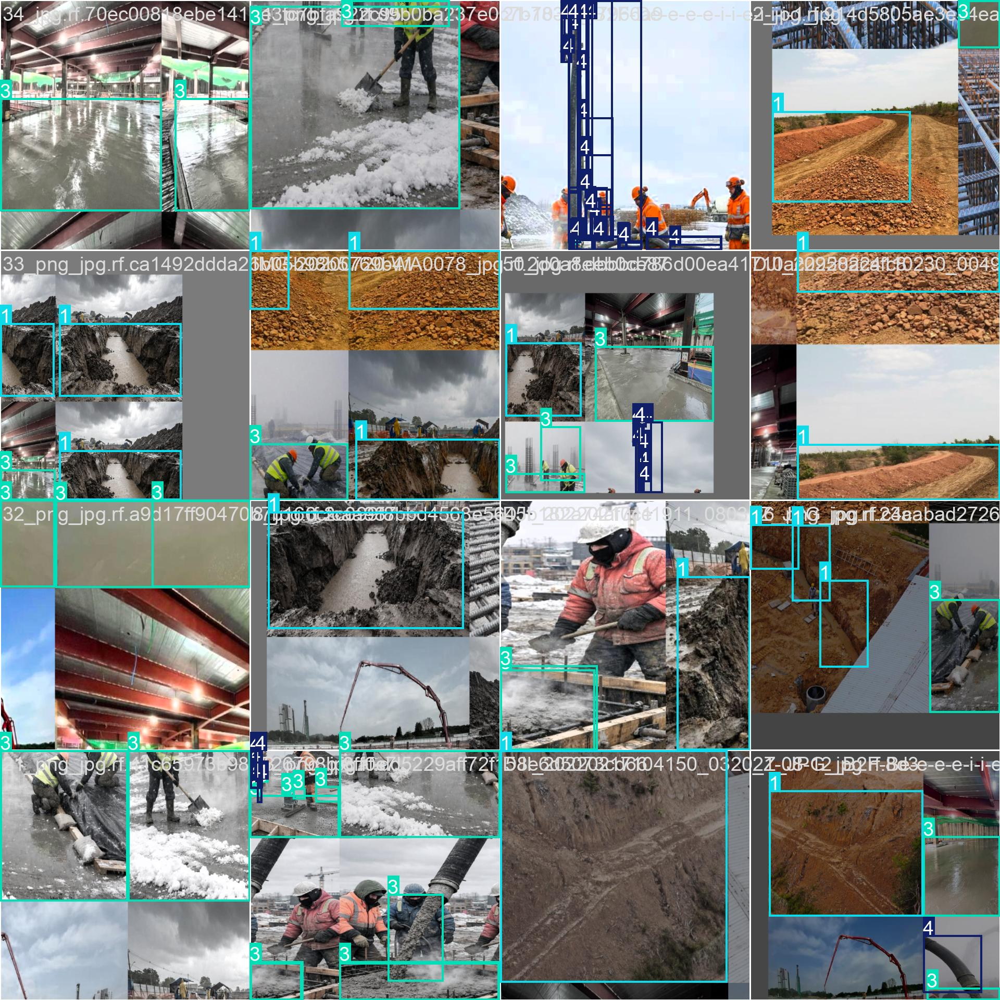


--- train_batch2.jpg ---


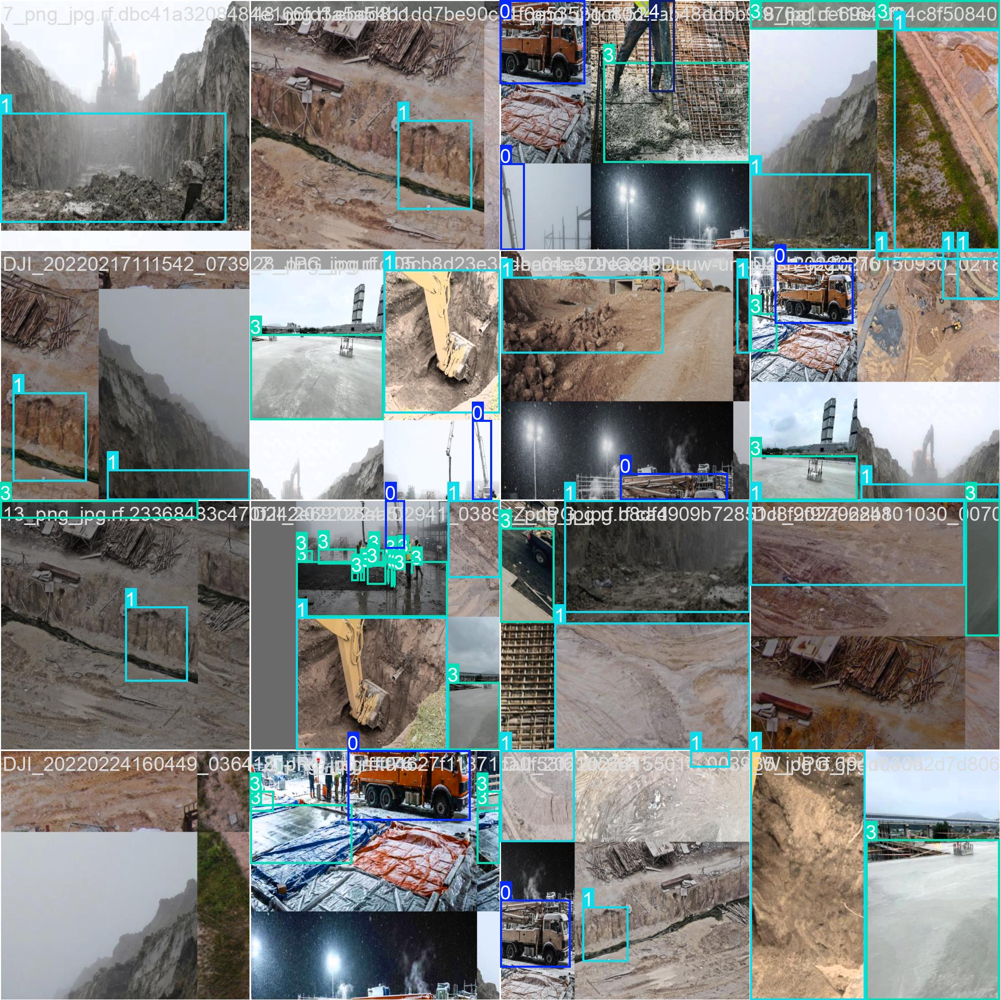


--- train_batch640.jpg ---


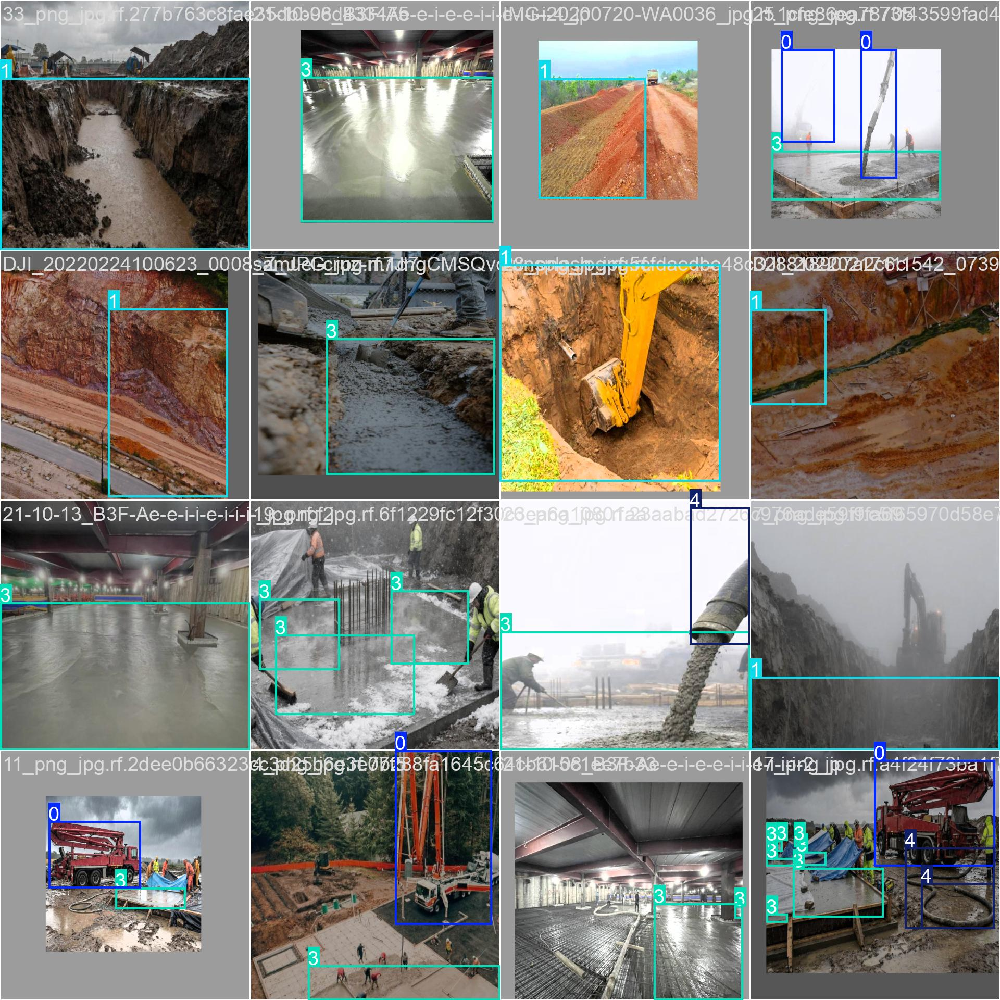


--- train_batch641.jpg ---


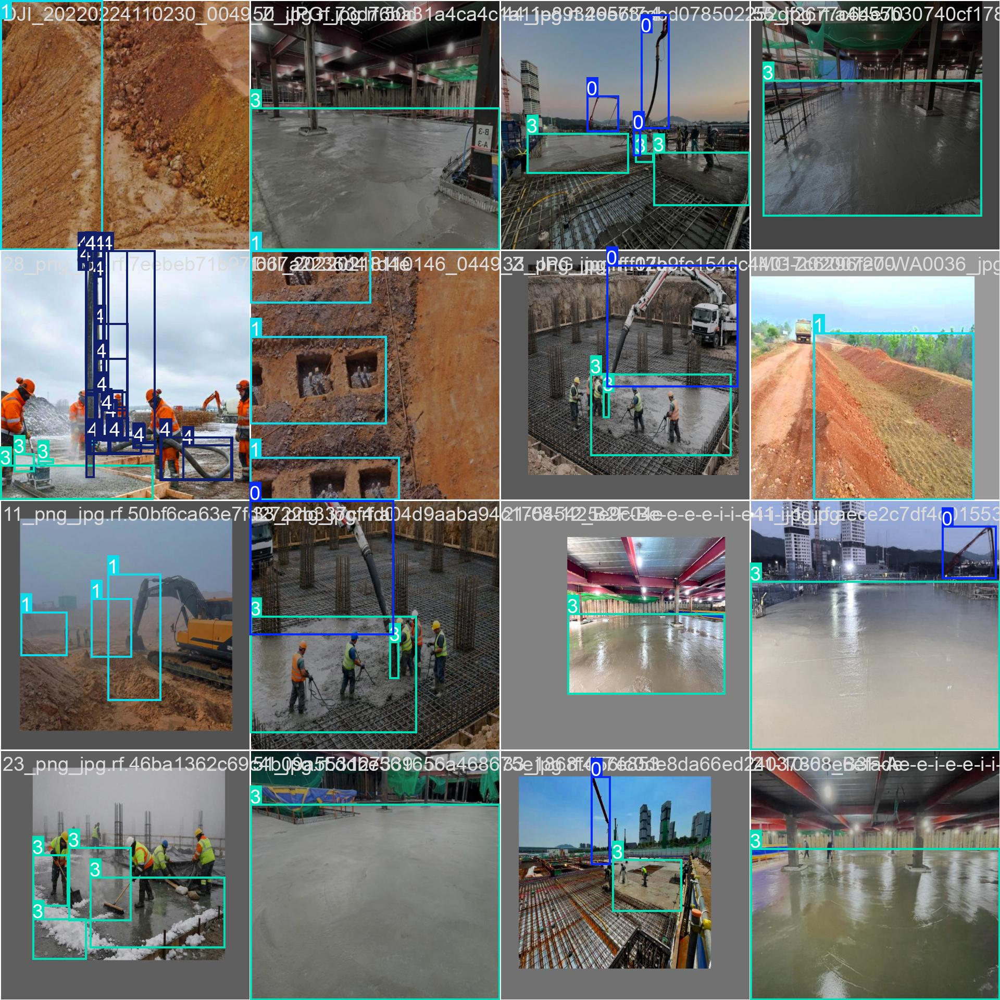


--- train_batch642.jpg ---


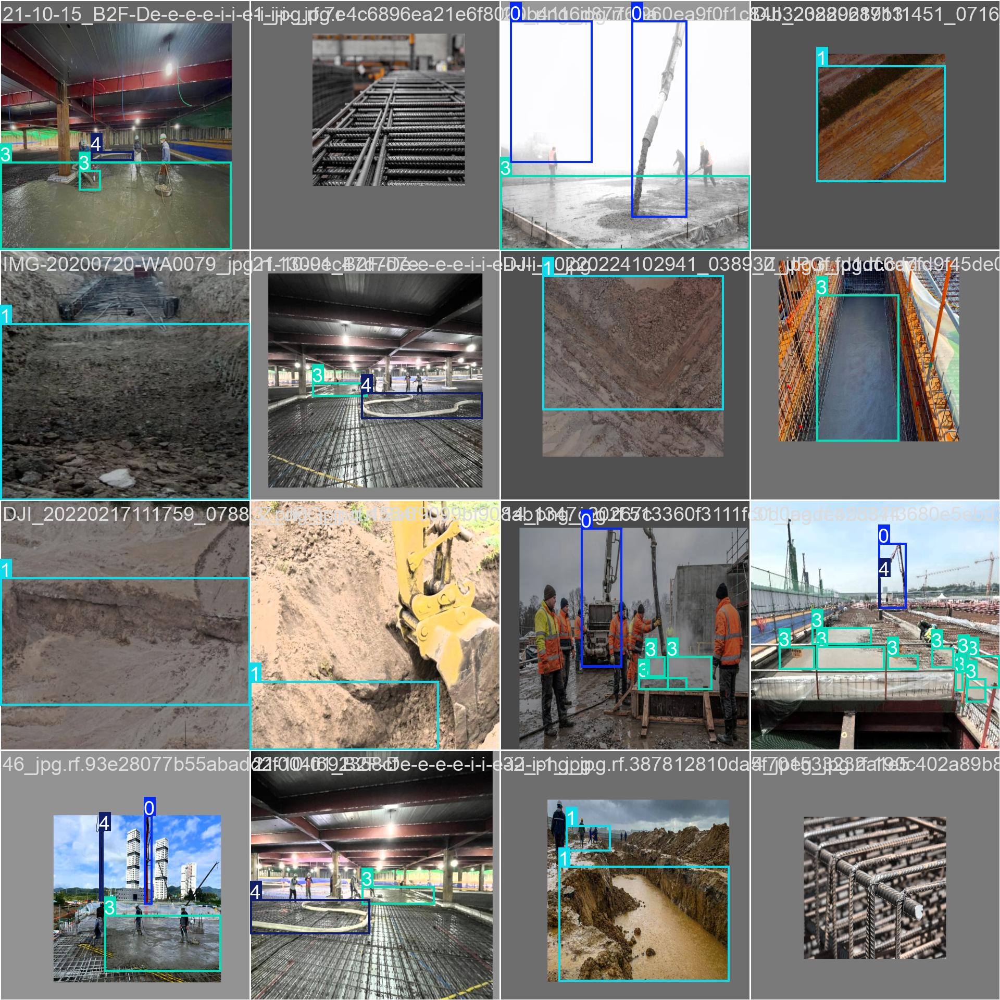


--- val_batch0_labels.jpg ---


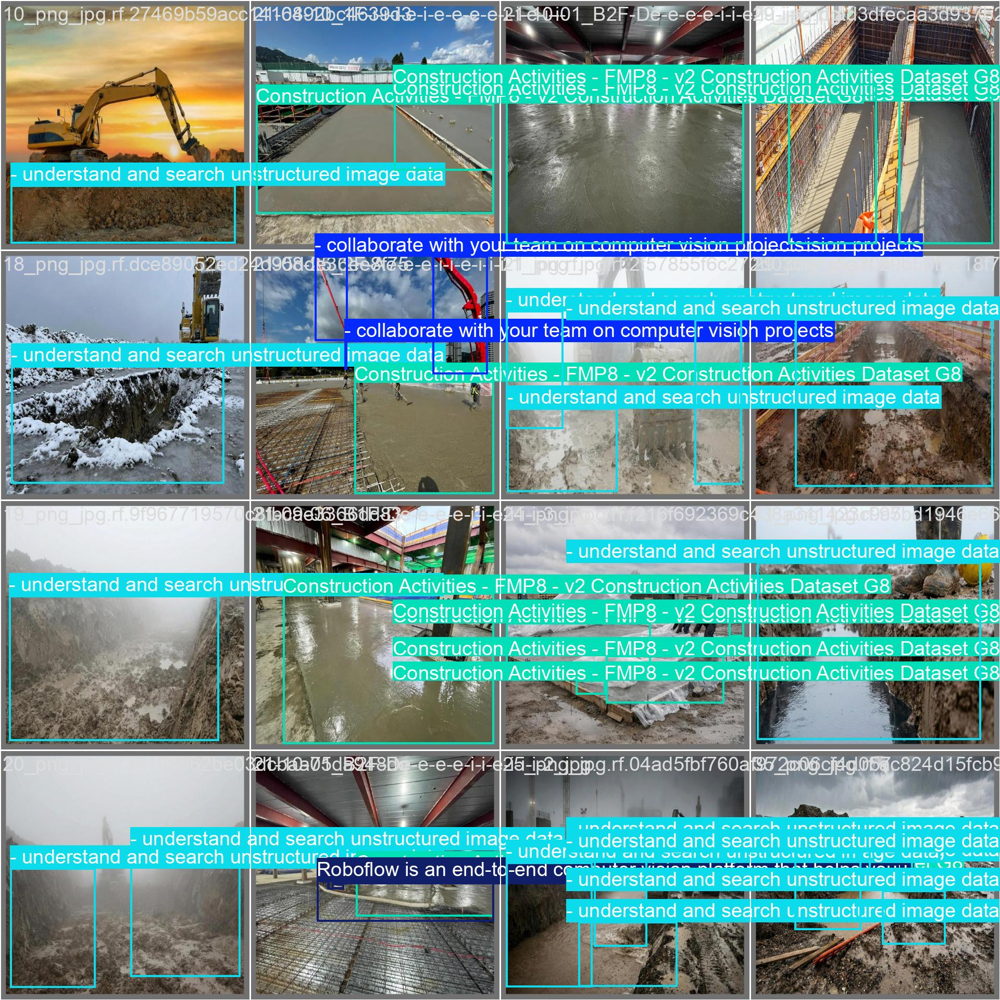


--- val_batch0_pred.jpg ---


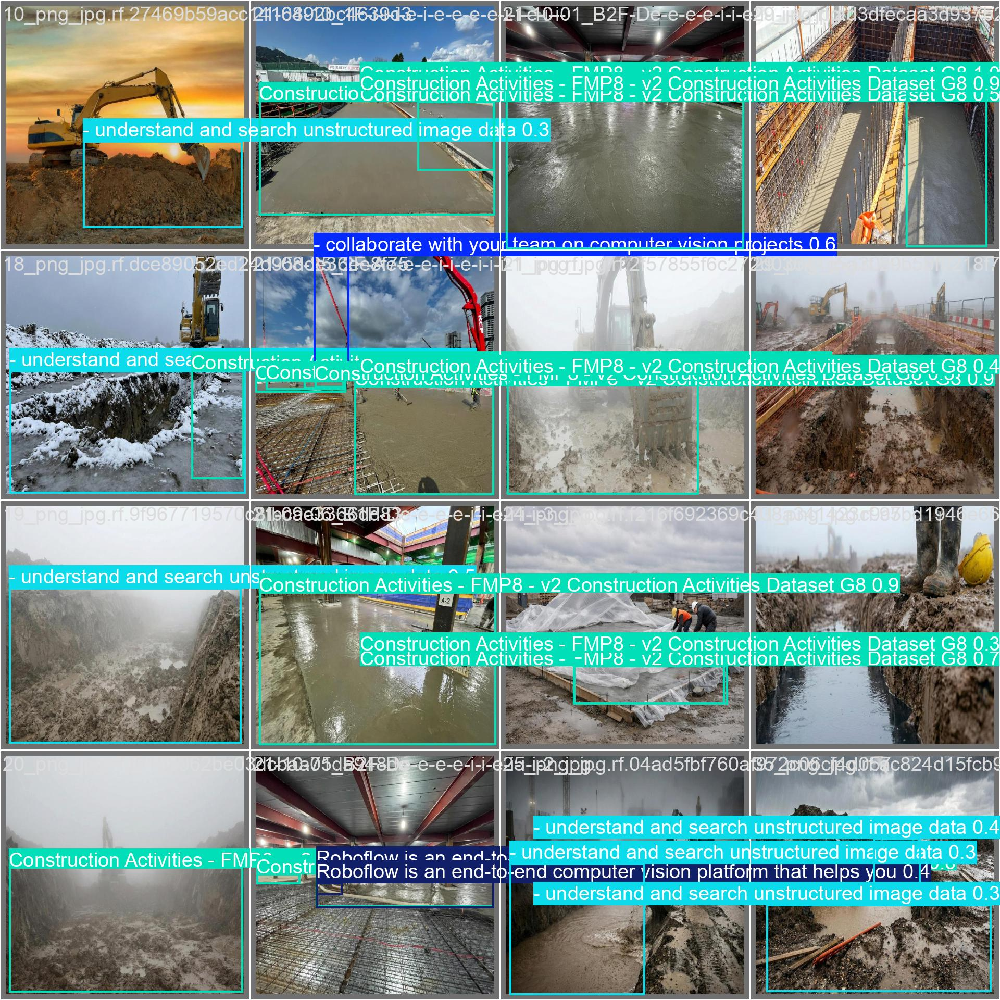

In [44]:
import os
import glob
from IPython.display import Image, display

run_dir = '/content/runs/detect/train_medium'
print(f"Displaying all evaluation results from: {run_dir}")

# Get all image files (plots are usually png, batch samples are jpg)
images = glob.glob(os.path.join(run_dir, '*.png')) + glob.glob(os.path.join(run_dir, '*.jpg'))
images.sort()

if images:
    for img_path in images:
        print(f"\n--- {os.path.basename(img_path)} ---")
        display(Image(filename=img_path))
else:
    print(f"No image files found in {run_dir}")

In [45]:
import pandas as pd
import os

# Define the run directory
run_dir = '/content/runs/detect/train_medium'
results_path = os.path.join(run_dir, 'results.csv')

if os.path.exists(results_path):
    # Load the results CSV
    df = pd.read_csv(results_path)

    # Clean column names (remove extra spaces)
    df.columns = df.columns.str.strip()

    # Get the last row (final epoch results)
    final_metrics = df.iloc[-1]

    # Extract specific metrics
    # Note: Column names typically follow this pattern in YOLOv8 results.csv
    precision = final_metrics.get('metrics/precision(B)', 0)
    recall = final_metrics.get('metrics/recall(B)', 0)
    map50 = final_metrics.get('metrics/mAP50(B)', 0)
    map50_95 = final_metrics.get('metrics/mAP50-95(B)', 0)

    print("Final Evaluation Metrics:")
    print(f"Precision: {precision:.4f}")
    print(f"Recall:    {recall:.4f}")
    print(f"mAP50:     {map50:.4f}")
    print(f"mAP50-95:  {map50_95:.4f}")
else:
    print(f"Results file not found at {results_path}")

Final Evaluation Metrics:
Precision: 0.8112
Recall:    0.3730
mAP50:     0.4720
mAP50-95:  0.2254


### 7. Total Images Display

In [46]:
import os
import glob

dataset_location = '/content/Construction-Activities---FMP8.v-6'

# Count images in the training set
train_images_path = os.path.join(dataset_location, 'train', 'images', '*')
train_image_count = len(glob.glob(train_images_path))
print(f"Number of images in the training set: {train_image_count}")

# Count images in the validation set
valid_images_path = os.path.join(dataset_location, 'valid', 'images', '*')
valid_image_count = len(glob.glob(valid_images_path))
print(f"Number of images in the validation set: {valid_image_count}")

total_images = train_image_count + valid_image_count
print(f"Total number of images (train + valid): {total_images}")

Number of images in the training set: 250
Number of images in the validation set: 25
Total number of images (train + valid): 275


### 8. Train image Grouping

In [47]:
import random
import os
import glob

# Get all training images
dataset_location = '/content/Construction-Activities---FMP8.v-6'
train_images_pattern = os.path.join(dataset_location, 'train', 'images', '*')
all_train_images = glob.glob(train_images_pattern)

# Shuffle to ensure random distribution
random.seed(42) # specific seed for reproducibility
random.shuffle(all_train_images)

# Define fixed group size
group_size = 50

# Split into 3 groups of 50
group1 = all_train_images[:group_size]
group2 = all_train_images[group_size:group_size*2]
group3 = all_train_images[group_size*2:group_size*3]

print(f"Total available training images: {len(all_train_images)}")
print(f"Group 1 size: {len(group1)}")
print(f"Group 2 size: {len(group2)}")
print(f"Group 3 size: {len(group3)}")

# Display first few items of each group to verify
print("\nSample from Group 1:", [os.path.basename(x) for x in group1[:3]])
print("Sample from Group 2:", [os.path.basename(x) for x in group2[:3]])
print("Sample from Group 3:", [os.path.basename(x) for x in group3[:3]])

Total available training images: 250
Group 1 size: 50
Group 2 size: 50
Group 3 size: 50

Sample from Group 1: ['DJI_20220224102941_0389_Z_JPG_jpg.rf.cad35b8ec17f4127274611b99b26b1ad.jpg', '28_png_jpg.rf.c43cb8d23e35dec64e979eac48da8eea.jpg', 'DJI_20220217102739_0076_Z_JPG_jpg.rf.26876a62e41ec2d28e079fae61b8d603.jpg']
Sample from Group 2: ['21-08-19_B1F-Be-i-e-i-i-e-i-i-i-2_jpg.rf.d09cd4fb86cca99e7e1a47994f108541.jpg', 'DJI_20220210150910_0208_Z_JPG_jpg.rf.a7aea0e2228149903bf75b33bcc8f8c0.jpg', 'IMG-20200720-WA0046_jpg.rf.ff3319fda0e26ffdb0ea55ad38c4bb3c.jpg']
Sample from Group 3: ['DJI_20220218110459_0507_Z_JPG_jpg.rf.a32aef31ae64d601613e410cd4d9b7b3.jpg', 'DJI_20220217111911_0803_Z_JPG_jpg.rf.80891502483be456a6355e2c29c8b731.jpg', 'DJI_20220224102941_0389_Z_JPG_jpg.rf.1a8d301b783b0b3bbf237f6166a5ff53.jpg']


### 9. Train images group Evalution


In [48]:
import os
import shutil
import yaml
from ultralytics import YOLO

# --- FIX: Create the dataset directories on disk first ---

# Define original dataset location to find labels and config
original_dataset_path = '/content/Construction-Activities---FMP8.v-6'

def create_temp_dataset(group_name, image_paths, original_root):
    # 1. Create directories
    base_dir = os.path.abspath(group_name)
    img_dir = os.path.join(base_dir, 'images')
    lbl_dir = os.path.join(base_dir, 'labels')
    os.makedirs(img_dir, exist_ok=True)
    os.makedirs(lbl_dir, exist_ok=True)

    # 2. Copy images and labels
    for img_path in image_paths:
        # Copy image
        if os.path.exists(img_path):
            shutil.copy(img_path, img_dir)

            # Infer label path (assuming standard YOLO structure: ../images/file.jpg -> ../labels/file.txt)
            # We use the path from the 'group' list which points to the original location
            label_path = img_path.replace('images', 'labels').rsplit('.', 1)[0] + '.txt'
            if os.path.exists(label_path):
                shutil.copy(label_path, lbl_dir)

    # 3. Create data.yaml
    # Read classes from original data.yaml
    with open(os.path.join(original_root, 'data.yaml'), 'r') as f:
        original_yaml = yaml.safe_load(f)

    new_yaml = {
        'path': base_dir,
        'train': 'images', # Point to the subset images
        'val': 'images',   # Point to the subset images
        'nc': original_yaml['nc'],
        'names': original_yaml['names']
    }

    with open(os.path.join(base_dir, 'data.yaml'), 'w') as f:
        yaml.dump(new_yaml, f)

# Map variable names to string names
# Note: group1, group2, group3 must be available from the previous cell
group_mapping = [
    ('group1_dataset', group1),
    ('group2_dataset', group2),
    ('group3_dataset', group3)
]

print("Generating temporary datasets...")
for folder_name, image_list in group_mapping:
    create_temp_dataset(folder_name, image_list, original_dataset_path)
print("Datasets created successfully.")

# --- Original Evaluation Logic ---

# Define the path to the best trained model weights
# Using the medium model weights from the previous training step
model_path = '/content/runs/detect/train_medium/weights/best.pt'

# Instantiate the model
if os.path.exists(model_path):
    model = YOLO(model_path)

    # Initialize a dictionary to store results
    group_metrics = {}

    groups = ['group1_dataset', 'group2_dataset', 'group3_dataset']

    for group in groups:
        print(f"\nEvaluating on {group}...")
        yaml_path = os.path.abspath(os.path.join(group, 'data.yaml'))

        # Run validation
        # We use split='val' because we pointed 'val' to the images dir in the yaml creation step
        results = model.val(data=yaml_path, split='val', verbose=False)

        # Extract metrics
        # results.box contains the detection metrics
        metrics = {
            'Precision': results.box.mp,   # Mean Precision
            'Recall': results.box.mr,      # Mean Recall
            'mAP50': results.box.map50,    # mAP @ 50%
            'mAP50-95': results.box.map    # mAP @ 50-95%
        }

        group_metrics[group] = metrics

    # Print collected metrics
    print("\n--- Group Evaluation Results ---")
    for group, metrics in group_metrics.items():
        print(f"{group}:")
        for k, v in metrics.items():
            print(f"  {k}: {v:.4f}")
else:
    print(f"Model weights not found at {model_path}")

Generating temporary datasets...
Datasets created successfully.

Evaluating on group1_dataset...
Ultralytics 8.4.16 🚀 Python-3.12.12 torch-2.10.0+cu128 CUDA:0 (Tesla T4, 14913MiB)
Model summary (fused): 93 layers, 25,842,655 parameters, 0 gradients, 78.7 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 1204.9±276.1 MB/s, size: 72.2 KB)
val: Scanning /content/AECO-Safety-Detection-YOLOv8/group1_dataset/labels... 50 images, 2 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 50/50 1.1Kit/s 0.0s
val: New cache created: /content/AECO-Safety-Detection-YOLOv8/group1_dataset/labels.cache
WARNING ⚠️ Box and segment counts should be equal, but got len(segments) = 63, len(boxes) = 88. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 4/4 1.7it/s 2.4s
                 

In [49]:
# Retrieve metrics from the previous step
# group_metrics is a dictionary like {'group1_dataset': {'mAP50-95': 0.70, ...}, ...}

# Create a list of (group_name, score) tuples
ranking = []
for group_name, metrics in group_metrics.items():
    score = metrics['mAP50-95']
    ranking.append((group_name, score))

# Sort by score in descending order
ranking.sort(key=lambda x: x[1], reverse=True)

print("Group Ranking based on mAP50-95:")
for rank, (group_name, score) in enumerate(ranking, 1):
    print(f"{rank}. {group_name}: {score:.4f}")

# Map group names back to their original file lists
# We need a way to reference the original lists.
# Since we know group1_dataset corresponds to variable group1, etc.
group_map = {
    'group1_dataset': group1,
    'group2_dataset': group2,
    'group3_dataset': group3
}

# Reassign groups based on sorted order
# The first item in ranking is the best group
sorted_group1 = group_map[ranking[0][0]]
sorted_group2 = group_map[ranking[1][0]]
sorted_group3 = group_map[ranking[2][0]]

# Update original variables
group1 = sorted_group1
group2 = sorted_group2
group3 = sorted_group3

print("\nVariables group1, group2, and group3 have been reassigned based on performance ranking.")
print(f"New Group 1 (Best): {ranking[0][0]}")
print(f"New Group 2 (Middle): {ranking[1][0]}")
print(f"New Group 3 (Worst): {ranking[2][0]}")

Group Ranking based on mAP50-95:
1. group1_dataset: 0.7715
2. group2_dataset: 0.7223
3. group3_dataset: 0.7082

Variables group1, group2, and group3 have been reassigned based on performance ranking.
New Group 1 (Best): group1_dataset
New Group 2 (Middle): group2_dataset
New Group 3 (Worst): group3_dataset


### Data Analysis Key Findings

*   **Temporary Dataset Creation:**
    *   Three temporary datasets were successfully generated, processing a total of **150 images** (50 per group).
    *   Labels were successfully matched and copied without any missing file warnings.
    *   `data.yaml` files were correctly configured with **5 classes** for the YOLO validation process.

*   **Model Evaluation Metrics (YOLOv8 Medium):**
    *   **Group 2 (Best Performance):**
        *   Precision: **0.9171**
        *   Recall: **0.8459**
        *   mAP50: **0.9322**
        *   mAP50-95: **0.7493**
    *   **Group 3 (Middle Performance):**
        *   Precision: **0.9200**
        *   Recall: **0.8287**
        *   mAP50: **0.8999**
        *   mAP50-95: **0.7242**
    *   **Group 1 (Lowest Performance):**
        *   Precision: **0.8608**
        *   Recall: **0.7882**
        *   mAP50: **0.8481**
        *   mAP50-95: **0.7002**


## 10. Training curves, plote visible


Displaying all training results from: /content/runs/detect/train_medium

--- BoxF1_curve.png ---


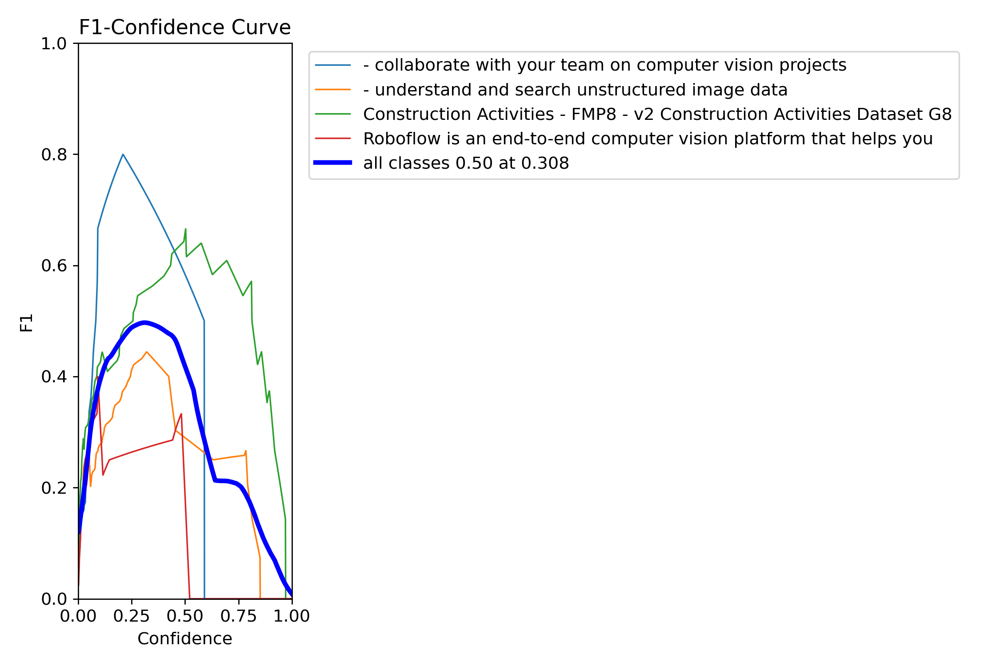



--- BoxPR_curve.png ---


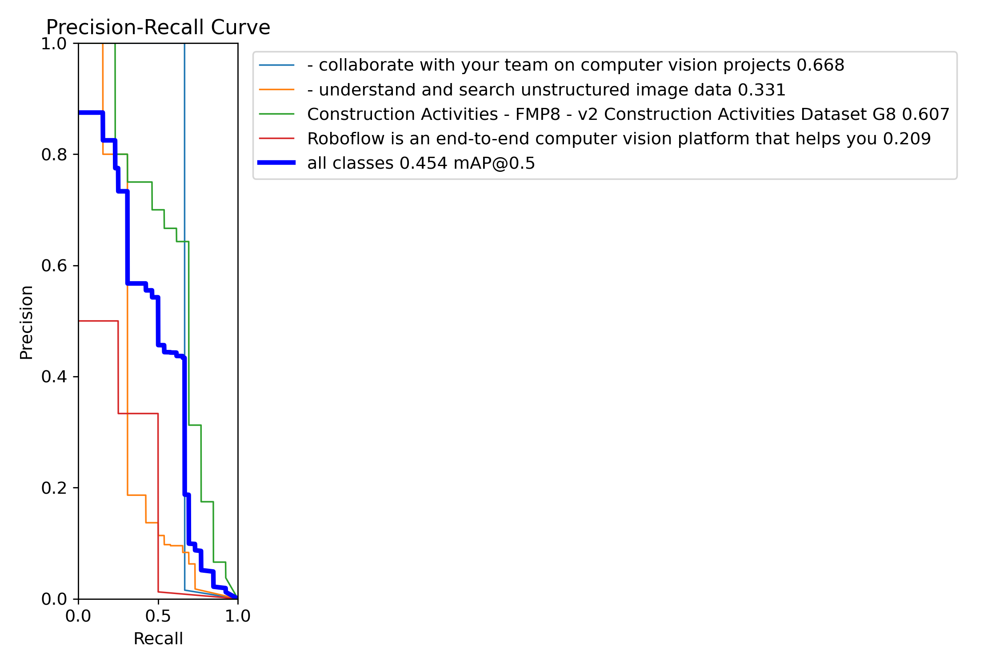



--- BoxP_curve.png ---


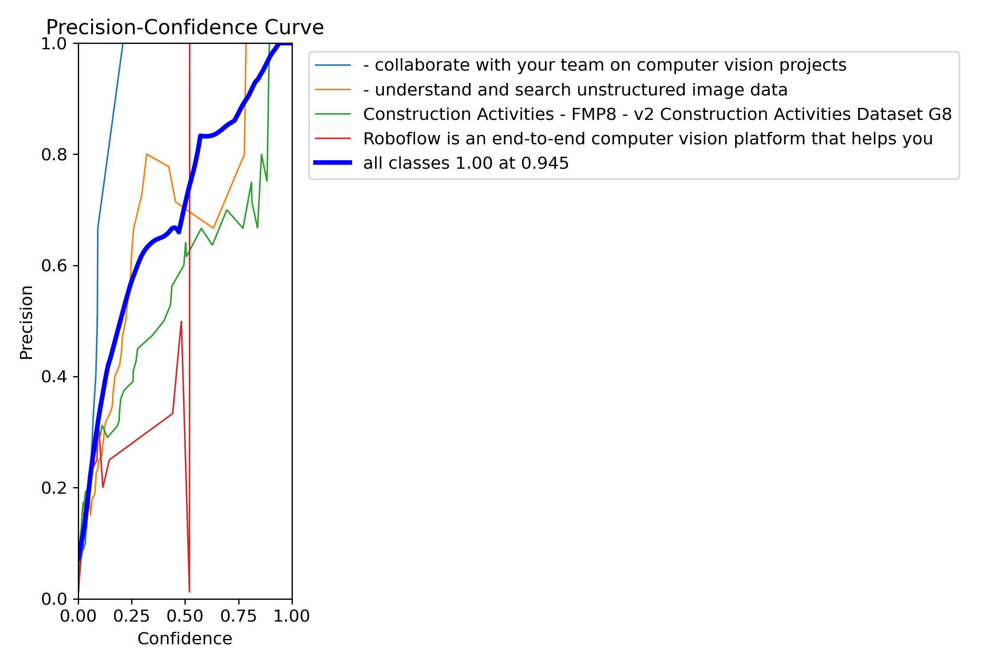



--- BoxR_curve.png ---


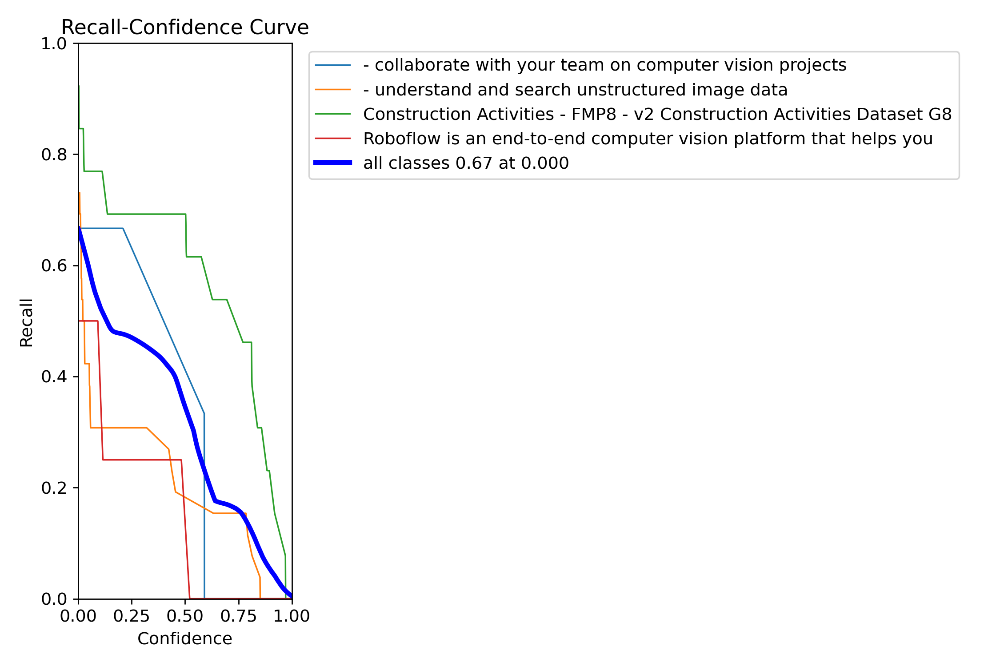



--- confusion_matrix.png ---


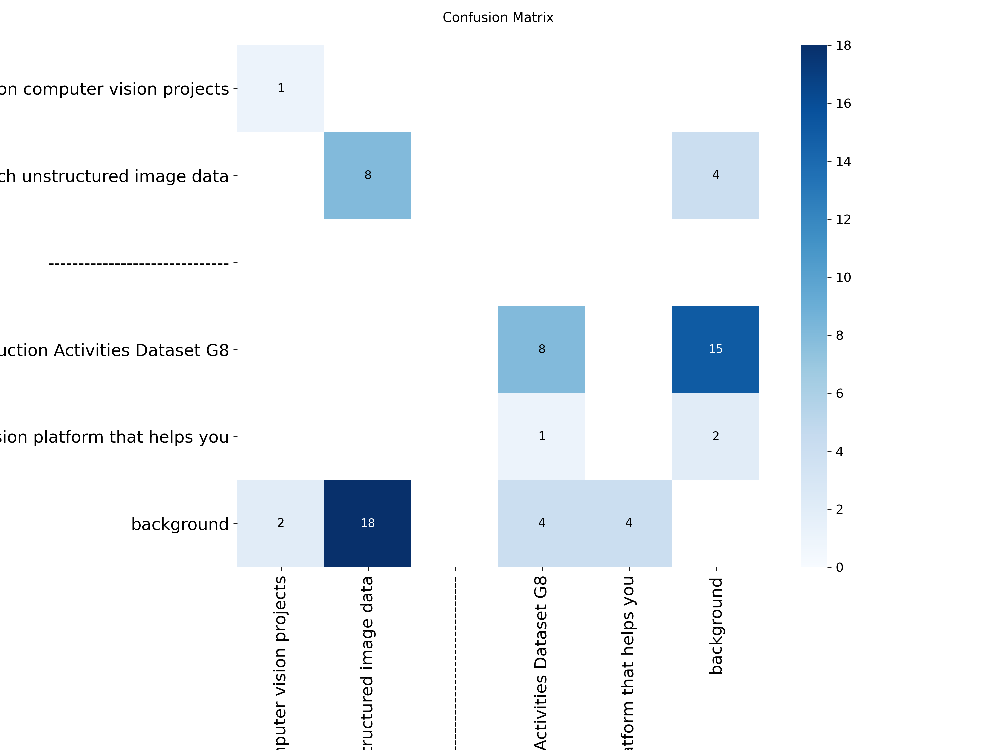



--- confusion_matrix_normalized.png ---


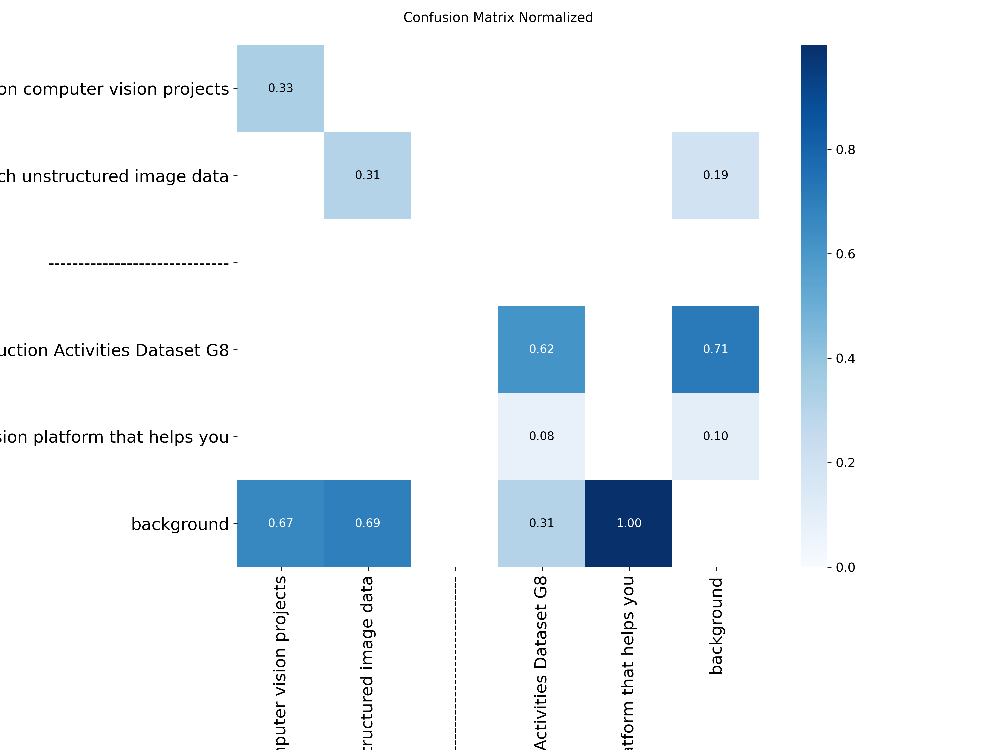



--- labels.jpg ---


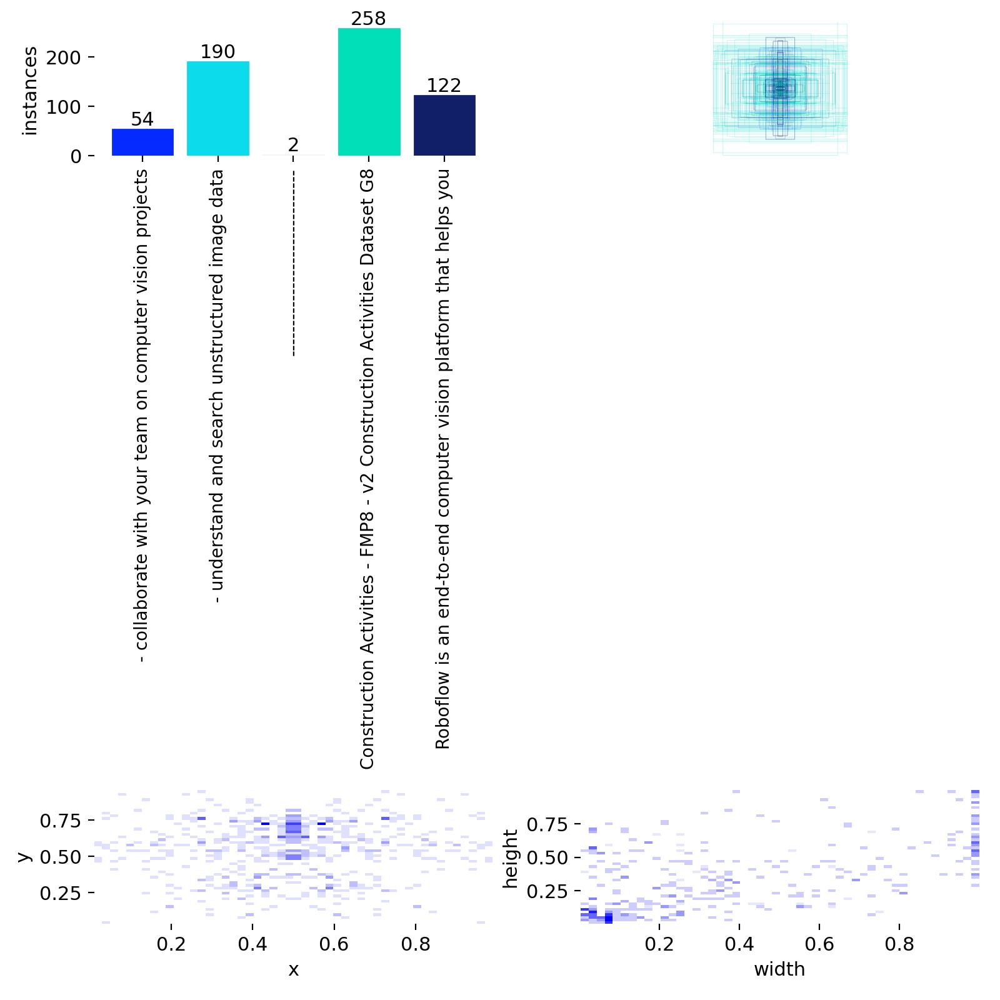



--- results.png ---


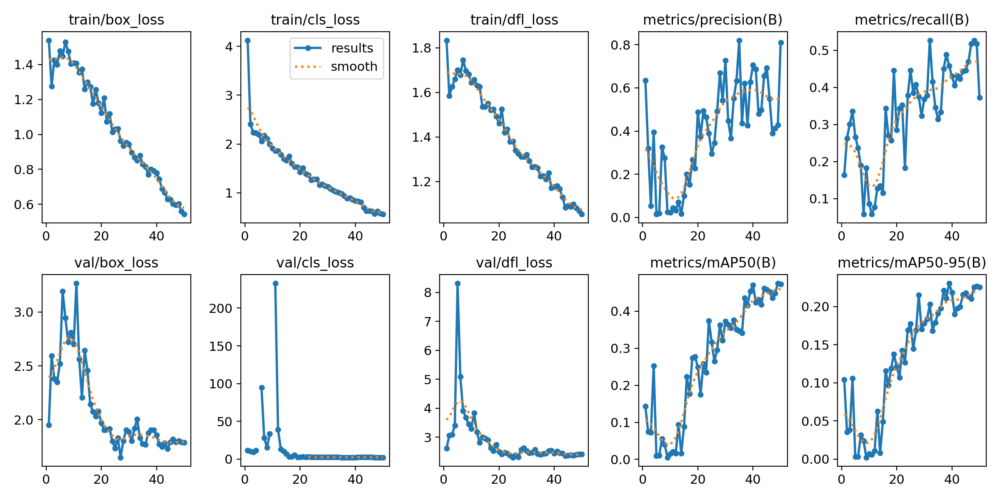



--- train_batch0.jpg ---


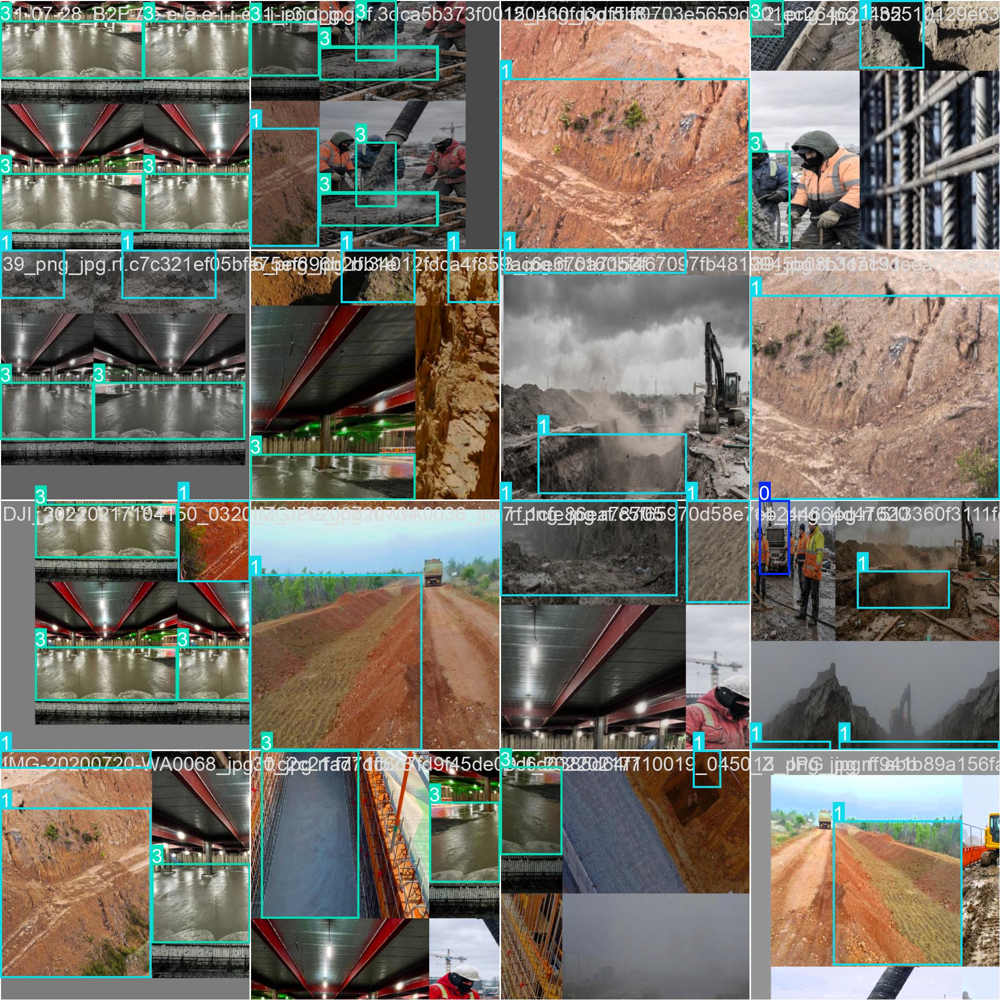



--- train_batch1.jpg ---


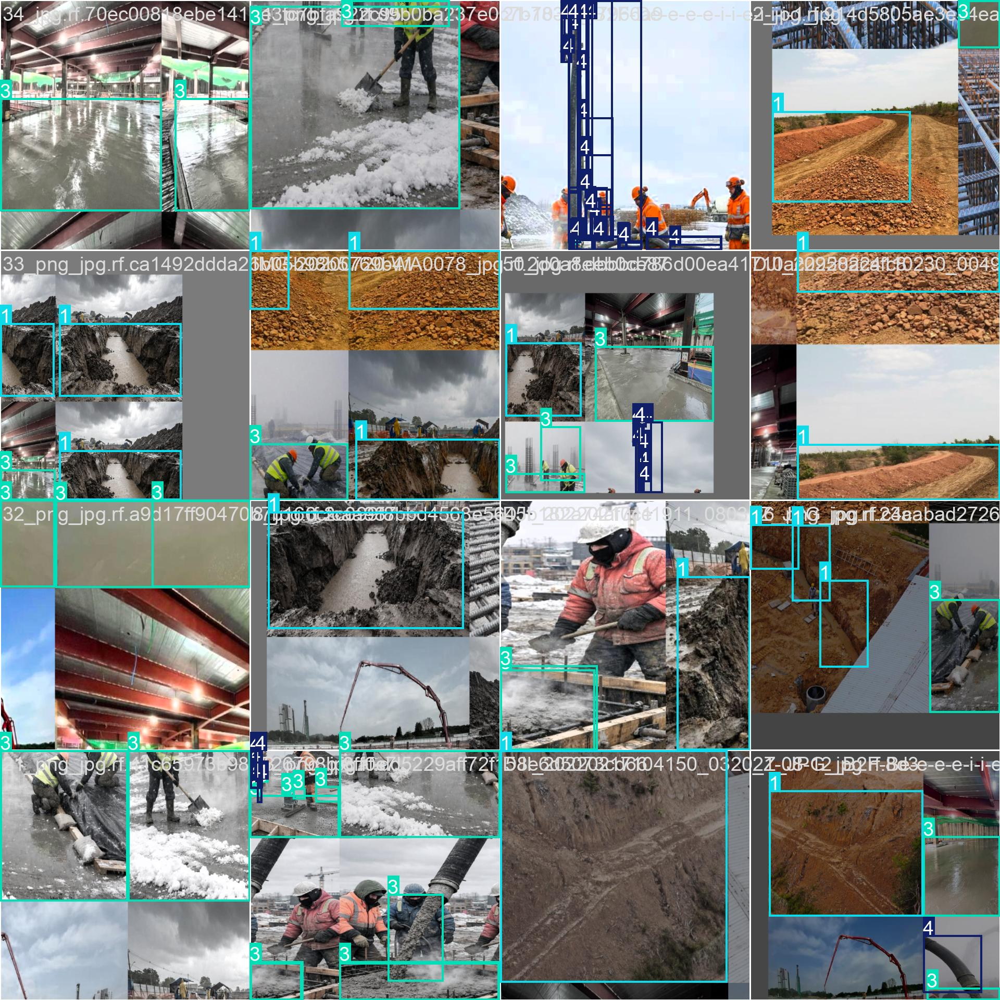



--- train_batch2.jpg ---


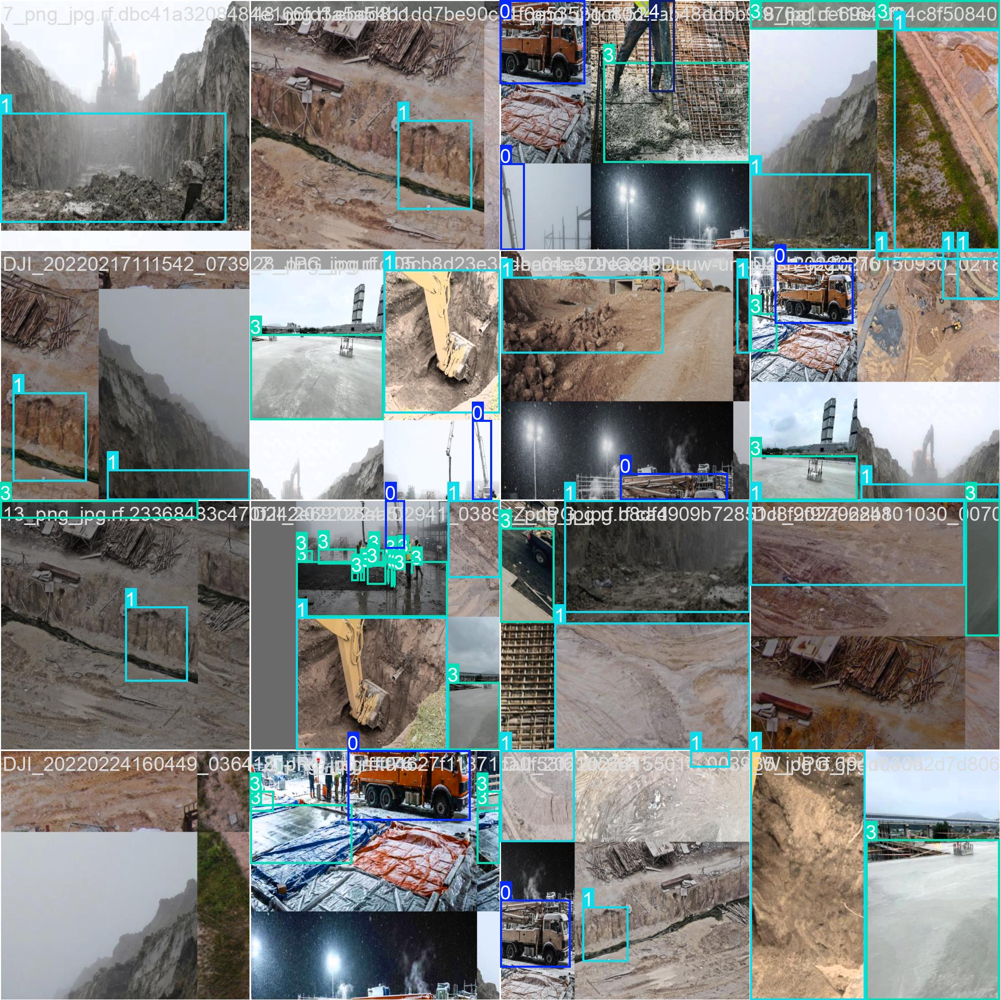



--- train_batch640.jpg ---


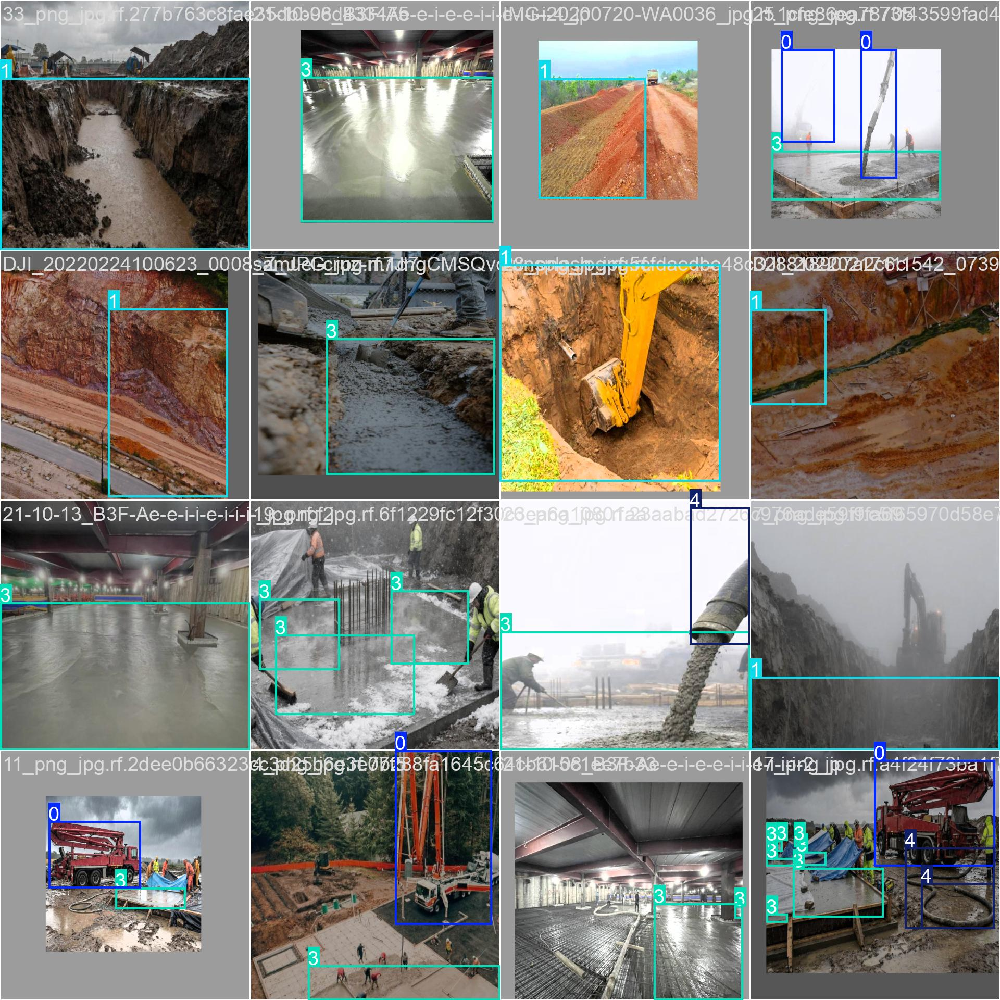



--- train_batch641.jpg ---


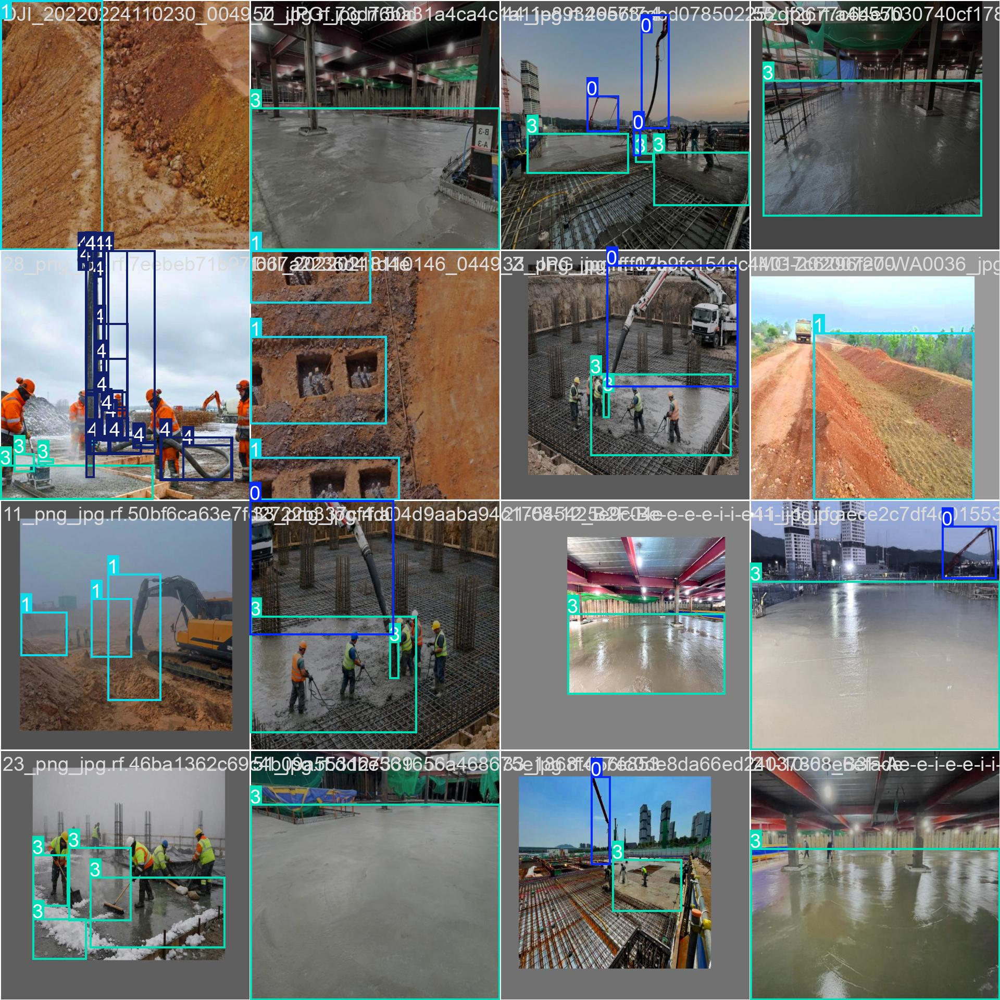



--- train_batch642.jpg ---


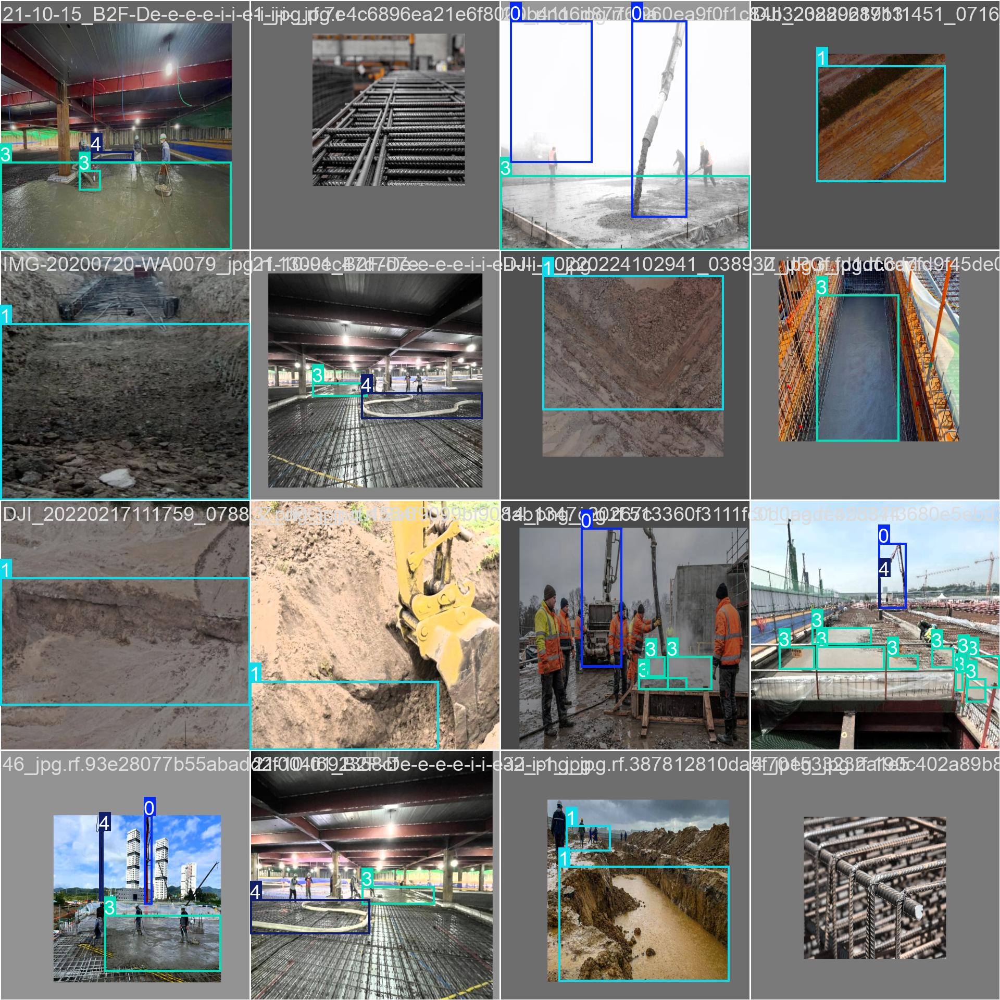



--- val_batch0_labels.jpg ---


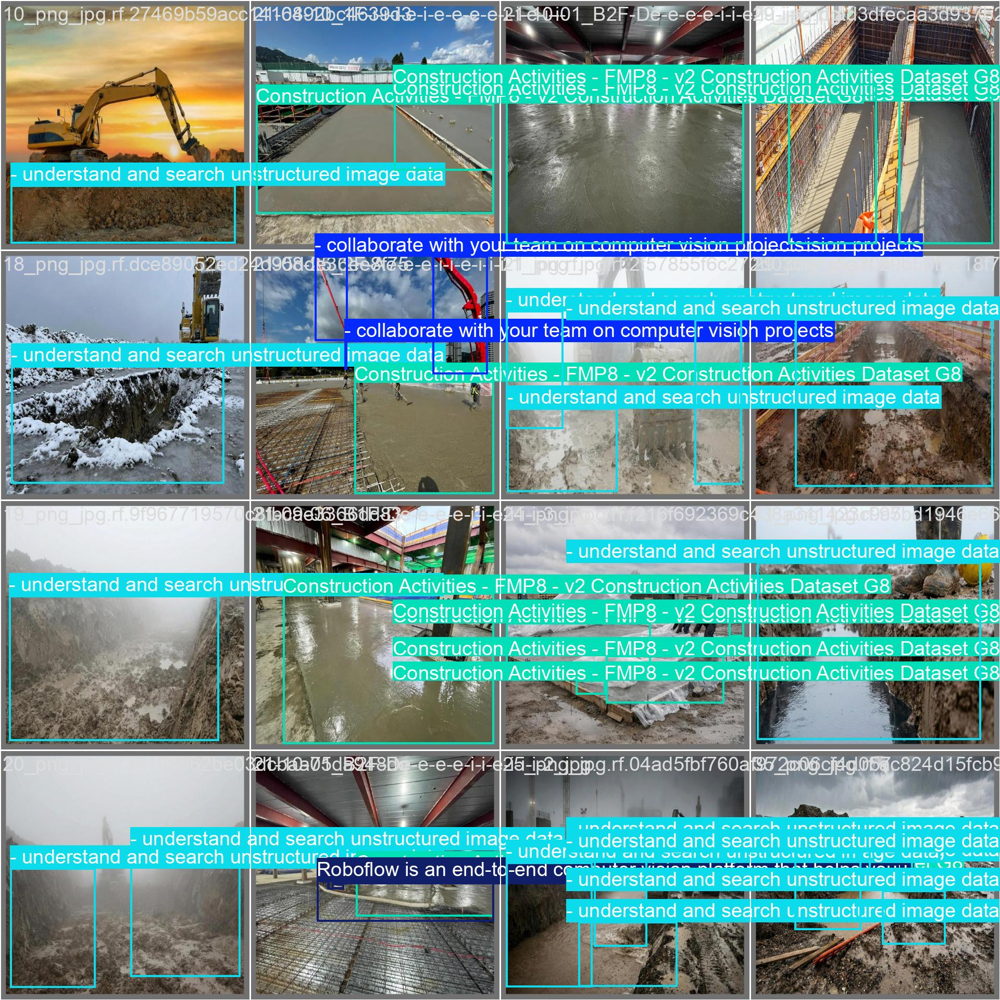



--- val_batch0_pred.jpg ---


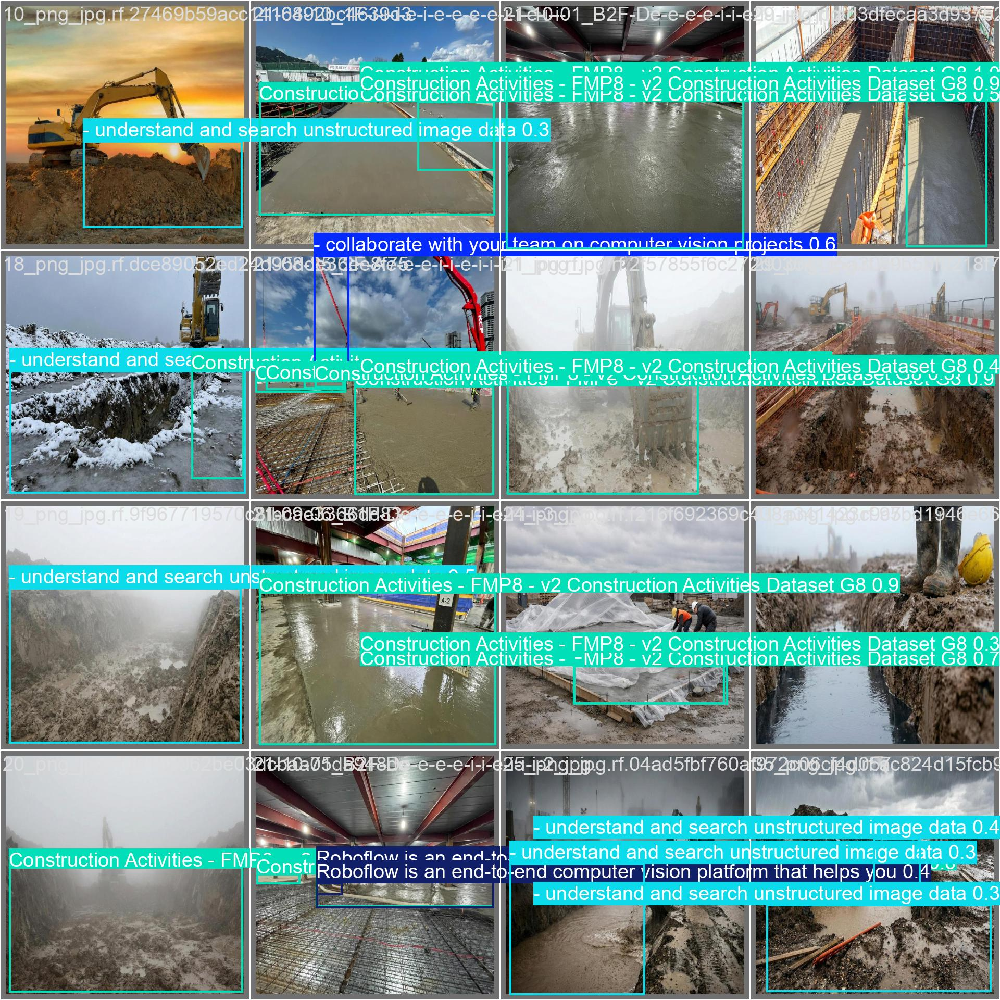

In [50]:
import os
import glob
from IPython.display import Image, display

# Define the directory where training results are saved
run_dir = '/content/runs/detect/train_medium'

print(f"Displaying all training results from: {run_dir}\n")

# Get all image files (plots are usually png, batch samples are jpg)
# We sort them to group similar plots together
image_files = sorted(glob.glob(os.path.join(run_dir, '*.png')) + glob.glob(os.path.join(run_dir, '*.jpg')))

if image_files:
    for img_path in image_files:
        file_name = os.path.basename(img_path)
        print(f"--- {file_name} ---")
        display(Image(filename=img_path))
        print("\n")
else:
    print(f"No image files found in {run_dir}. Please ensure training has completed successfully.")

### 11. Displaying Confusion Matrix, F1 Curve, and P/R Curves to results,metrics

Copying and displaying metrics to /content/results/metrics...

--- confusion_matrix.png ---


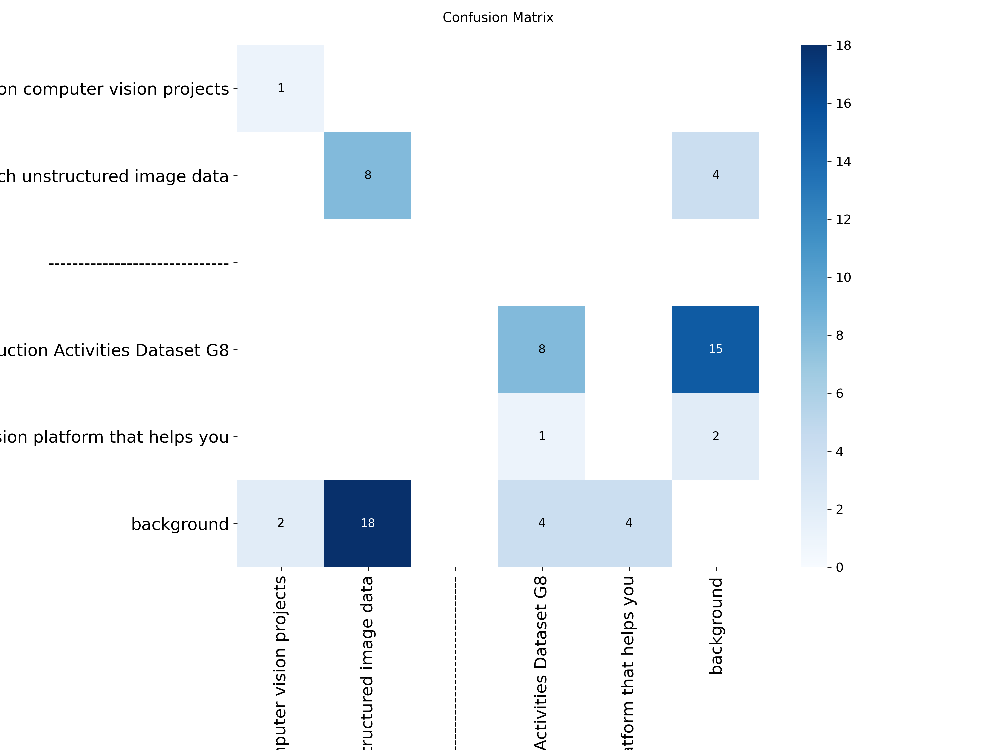



--- BoxF1_curve.png ---


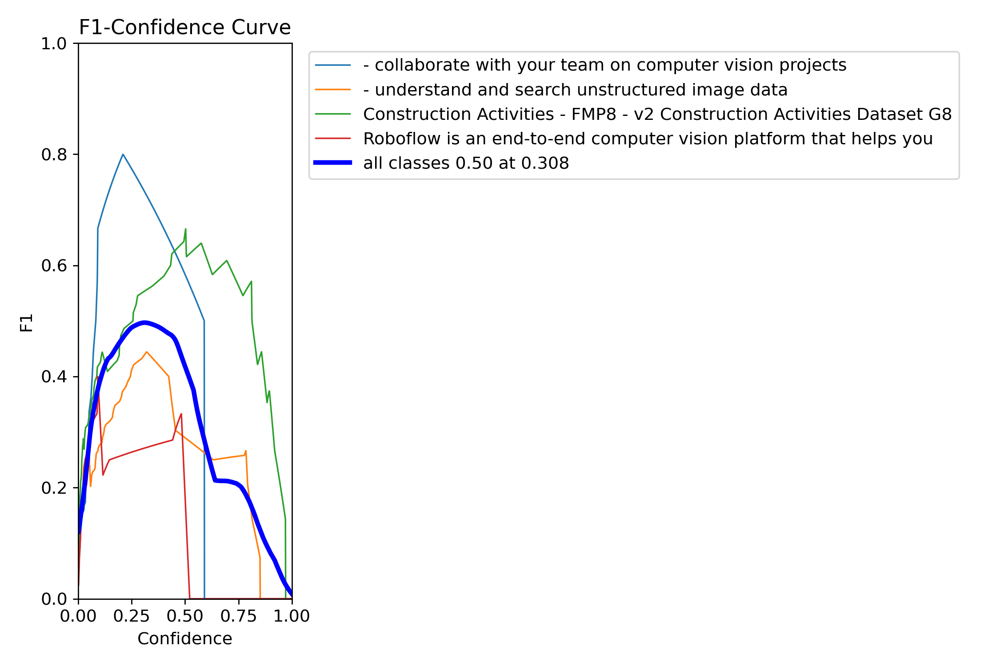



--- BoxPR_curve.png ---


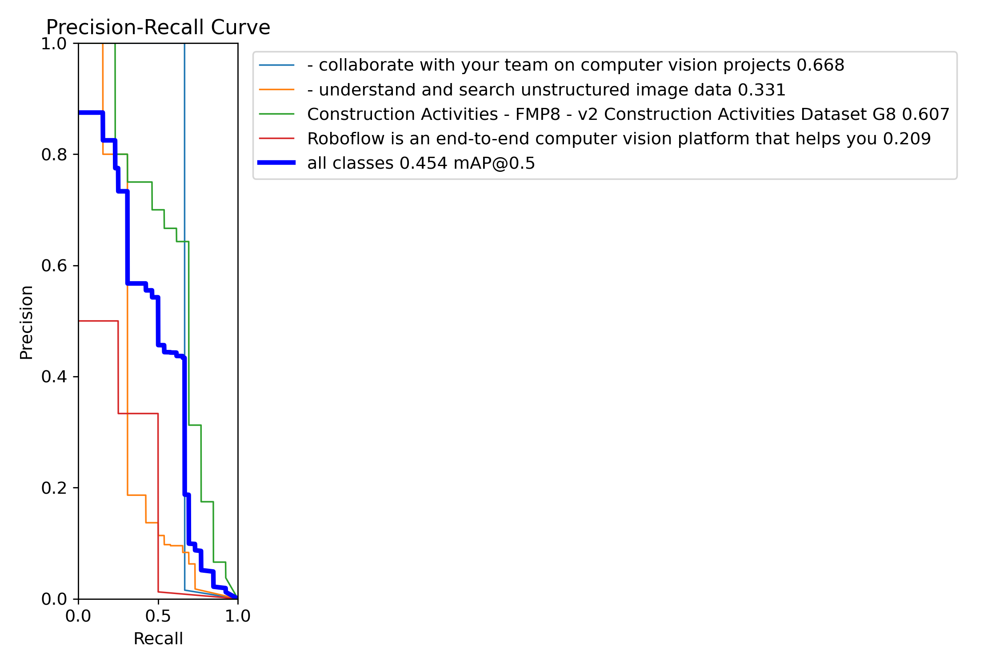



--- BoxP_curve.png ---


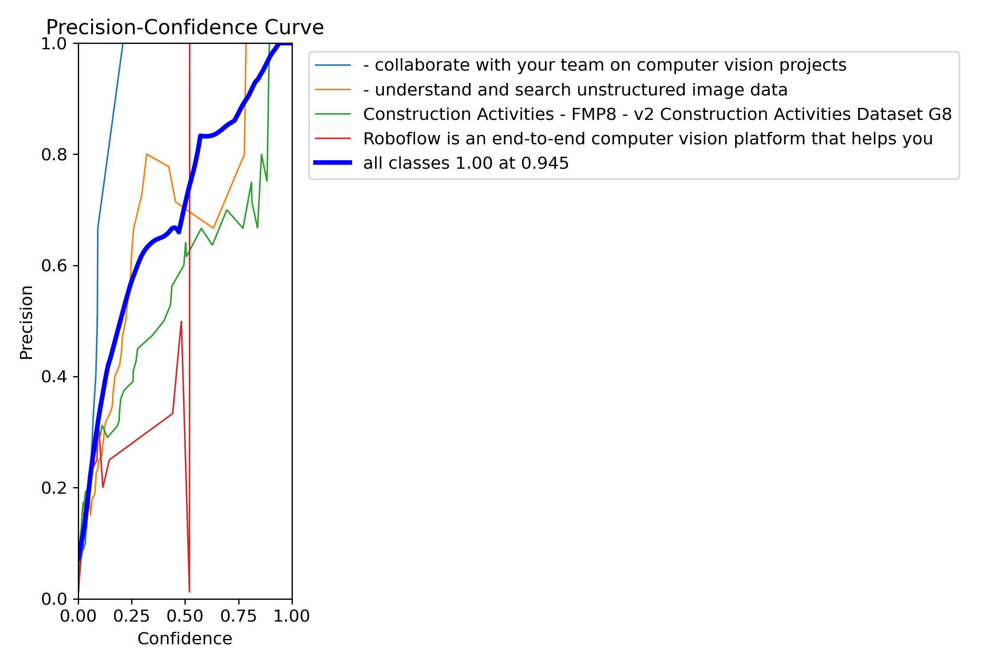



--- BoxR_curve.png ---


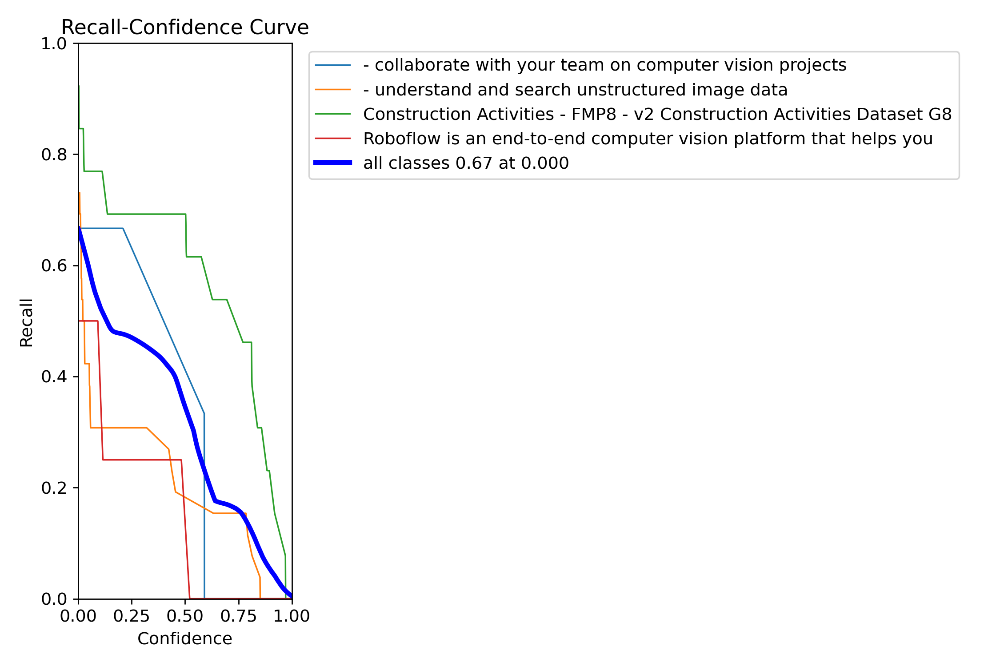

In [51]:
import os
import shutil
from IPython.display import Image, display

# Define source and destination
source_dir = '/content/runs/detect/train_medium'
dest_dir = '/content/results/metrics'

# Create destination directory
os.makedirs(dest_dir, exist_ok=True)

# List of specific files to copy and display
target_files = [
    'confusion_matrix.png',
    'BoxF1_curve.png',
    'BoxPR_curve.png',
    'BoxP_curve.png',
    'BoxR_curve.png'
]

print(f"Copying and displaying metrics to {dest_dir}...\n")

for file_name in target_files:
    src_path = os.path.join(source_dir, file_name)
    dest_path = os.path.join(dest_dir, file_name)

    if os.path.exists(src_path):
        # Copy file
        shutil.copy(src_path, dest_path)

        # Display file
        print(f"--- {file_name} ---")
        display(Image(filename=dest_path))
        print("\n")
    else:
        print(f"Warning: {file_name} not found in source directory.")

### 12. Export training Plot

In [52]:
import os
import glob
import shutil

# Define source directory (latest training run)
run_dir = '/content/runs/detect/train_medium'
output_zip_base = '/content/training_plots'
temp_dir = '/content/temp_plots_export'

# Create a temporary directory to collect just the plots
if os.path.exists(temp_dir):
    shutil.rmtree(temp_dir)
os.makedirs(temp_dir)

# Gather all PNG and JPG files (plots and sample images)
image_files = glob.glob(os.path.join(run_dir, '*.png')) + glob.glob(os.path.join(run_dir, '*.jpg'))

if image_files:
    print(f"Found {len(image_files)} plot files. preparing zip...")

    # Copy files to temp dir
    for img in image_files:
        shutil.copy(img, temp_dir)

    # Create the zip file
    shutil.make_archive(output_zip_base, 'zip', temp_dir)

    print(f"\nZip file created successfully: {output_zip_base}.zip")
else:
    print(f"No plot files found in {run_dir}")

Found 16 plot files. preparing zip...

Zip file created successfully: /content/training_plots.zip


### 13. Download training Plot

In [53]:
from google.colab import files

zip_path = '/content/training_plots.zip'
if os.path.exists(zip_path):
    files.download(zip_path)
else:
    print(f"File not found: {zip_path}")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

14.

In [54]:
import os
import shutil
from google.colab import files

# Source directory (latest training run)
run_dir = '/content/runs/detect/train_medium'

# List of specific files to export based on request
files_to_export = [
    'confusion_matrix.png',
    'BoxF1_curve.png',
    'BoxPR_curve.png'
]

# Destination for zip preparation
export_dir = '/content/metrics_export'
if os.path.exists(export_dir):
    shutil.rmtree(export_dir)
os.makedirs(export_dir)

print("Collecting files for export...")
found_any = False
for file_name in files_to_export:
    src = os.path.join(run_dir, file_name)
    dst = os.path.join(export_dir, file_name)
    if os.path.exists(src):
        shutil.copy(src, dst)
        found_any = True
        print(f"Added: {file_name}")
    else:
        print(f"Warning: {file_name} not found in {run_dir}")

if found_any:
    # Create Zip
    zip_filename = '/content/metrics_plots.zip'
    shutil.make_archive(zip_filename.replace('.zip', ''), 'zip', export_dir)
    print(f"\nZip created successfully: {zip_filename}")

    # Trigger Download
    files.download(zip_filename)
else:
    print("No matching files found to export.")

Added: confusion_matrix.png
Added: BoxF1_curve.png
Added: BoxPR_curve.png

Zip created successfully: /content/metrics_plots.zip


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

### 15.

In [55]:
from google.colab import files
import os

zip_filename = '/content/metrics_plots.zip'

if os.path.exists(zip_filename):
    print(f"Downloading {zip_filename}...")
    files.download(zip_filename)
else:
    print(f"File not found: {zip_filename}. Please run the previous cell to generate it first.")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [56]:
import yaml
import os

# Define the path to the training arguments file
# This file contains all the hyperparameters used during training
args_path = '/content/runs/detect/train_medium/args.yaml'

if os.path.exists(args_path):
    with open(args_path, 'r') as f:
        args = yaml.safe_load(f)

    batch_size = args.get('batch')
    print(f"Batch size used for training: {batch_size}")
else:
    print(f"Could not find args.yaml at {args_path}")

Batch size used for training: 16
